

Dataset: https://www.kaggle.com/datasets/mertkkl/manga-facial-expressions



VGG16 code based on https://www.kaggle.com/code/stpeteishii/manga-face-densenet201

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import tqdm
import os
import sys
import matplotlib.pyplot as plt
import tensorflow as tf
import psutil
import time

from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.image import ImageDataGenerator
from PIL import Image

from sklearn.metrics import classification_report, log_loss, accuracy_score
from sklearn.model_selection import train_test_split

import inspect
import time

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

for dirname, _, filenames in os.walk('/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train'):
    for filename in filenames:
        #print(os.path.join(dirname, filename))
        os.path.join(dirname, filename)

categories=[]
for file in os.listdir('/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train'):
    categories+=[file]
print(categories)

directoryTrain = '/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train'
directoryTest = '/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Test'

Mounted at /content/drive
['sad', 'pleased', 'shock', 'angry', 'crying', 'happy', 'embarrassed']


In [ ]:
N=[]
for i in range(len(categories)):
    N+=[i]

normal_mapping=dict(zip(categories,N))
reverse_mapping=dict(zip(N,categories))

def mapper(value):
    return reverse_mapping[value]

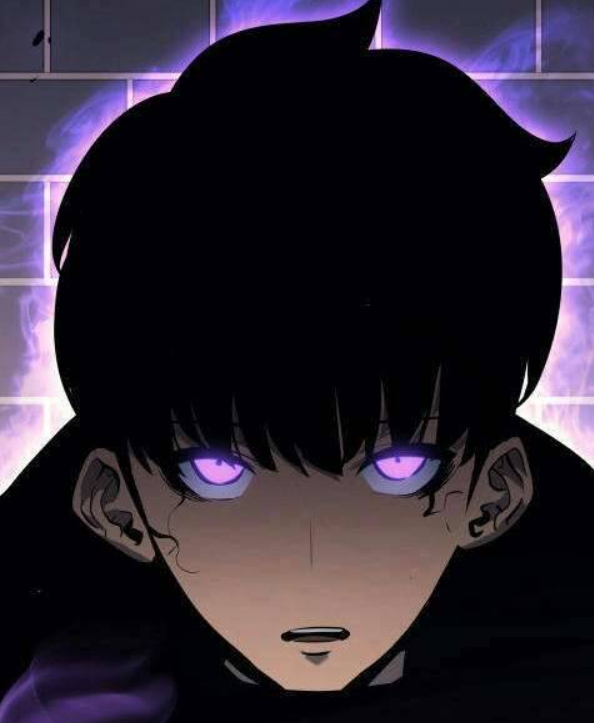

In [ ]:
i=Image.open("/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/angry/Screenshot 2023-07-25 220121.png")
i

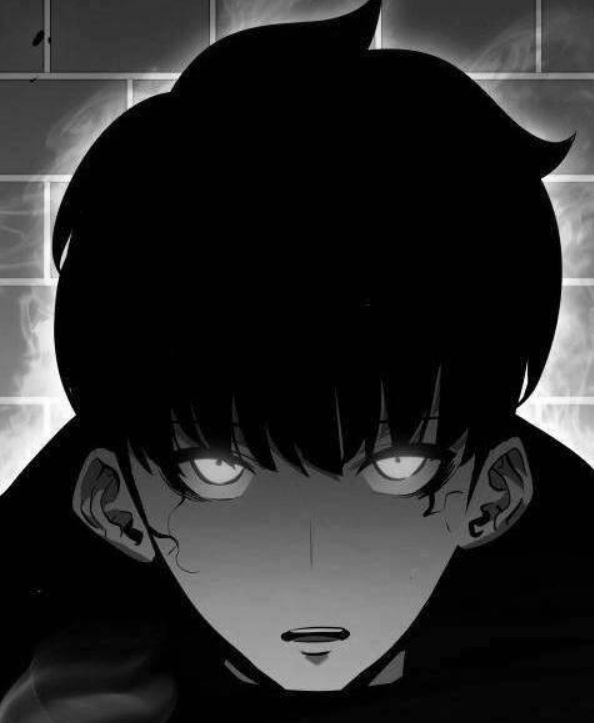

In [ ]:
i=i.convert("L")
i

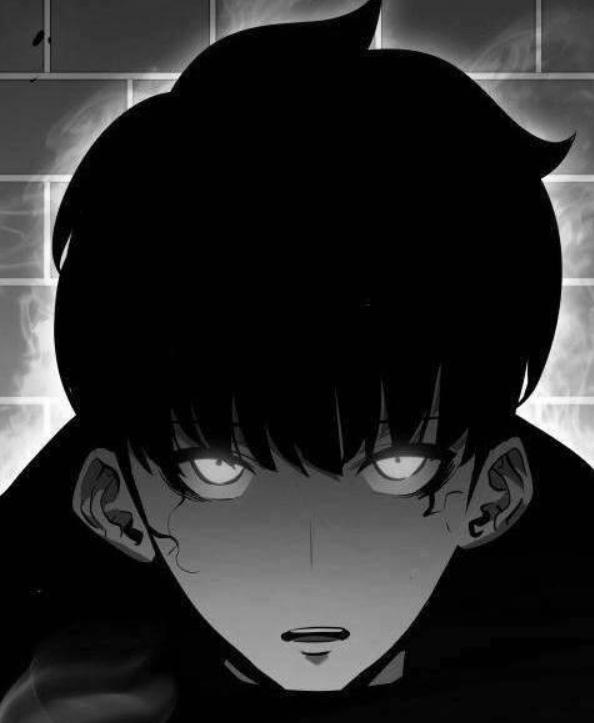

In [ ]:
i=Image.merge("RGB", [i] * 3)
i

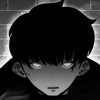

In [ ]:
i=i.resize((100,100))
i

In [ ]:
r=np.array(i)
r

array([[[51, 51, 51],
        [52, 52, 52],
        [52, 52, 52],
        ...,
        [55, 55, 55],
        [54, 54, 54],
        [52, 52, 52]],

       [[51, 51, 51],
        [52, 52, 52],
        [52, 52, 52],
        ...,
        [62, 62, 62],
        [60, 60, 60],
        [59, 59, 59]],

       [[52, 52, 52],
        [54, 54, 54],
        [52, 52, 52],
        ...,
        [69, 69, 69],
        [67, 67, 67],
        [66, 66, 66]],

       ...,

       [[80, 80, 80],
        [70, 70, 70],
        [43, 43, 43],
        ...,
        [ 6,  6,  6],
        [ 8,  8,  8],
        [ 8,  8,  8]],

       [[81, 81, 81],
        [47, 47, 47],
        [36, 36, 36],
        ...,
        [ 6,  6,  6],
        [ 6,  6,  6],
        [ 5,  5,  5]],

       [[61, 61, 61],
        [42, 42, 42],
        [35, 35, 35],
        ...,
        [ 6,  6,  6],
        [ 6,  6,  6],
        [ 6,  6,  6]]], dtype=uint8)

In [ ]:
r=r/255
r

array([[[0.2       , 0.2       , 0.2       ],
        [0.20392157, 0.20392157, 0.20392157],
        [0.20392157, 0.20392157, 0.20392157],
        ...,
        [0.21568627, 0.21568627, 0.21568627],
        [0.21176471, 0.21176471, 0.21176471],
        [0.20392157, 0.20392157, 0.20392157]],

       [[0.2       , 0.2       , 0.2       ],
        [0.20392157, 0.20392157, 0.20392157],
        [0.20392157, 0.20392157, 0.20392157],
        ...,
        [0.24313725, 0.24313725, 0.24313725],
        [0.23529412, 0.23529412, 0.23529412],
        [0.23137255, 0.23137255, 0.23137255]],

       [[0.20392157, 0.20392157, 0.20392157],
        [0.21176471, 0.21176471, 0.21176471],
        [0.20392157, 0.20392157, 0.20392157],
        ...,
        [0.27058824, 0.27058824, 0.27058824],
        [0.2627451 , 0.2627451 , 0.2627451 ],
        [0.25882353, 0.25882353, 0.25882353]],

       ...,

       [[0.31372549, 0.31372549, 0.31372549],
        [0.2745098 , 0.2745098 , 0.2745098 ],
        [0.16862745, 0

In [ ]:
trainset=[]
testset1=[]
count=0
ctrain=0
list_sad=[]
list_pleased=[]
list_shock=[]
list_angry=[]
list_crying=[]
list_happy=[]
list_embarrassed=[]
for file in os.listdir(directoryTrain):
    path=os.path.join(directoryTrain,file)
    t=0
    for im in os.listdir(path):
        ctrain = ctrain + 1
        image=Image.open(os.path.join(path,im))
        image=image.convert("L")
        image=Image.merge("RGB", [image] * 3)
        image=image.resize((100,100))
        image=np.array(image)
        #image=load_img(os.path.join(path,im), grayscale=False, color_mode='rgb', target_size=(100,100))
        #image=img_to_array(image)
        image=image/255.0
        trainset.append([image,count])
        if count == 0: list_sad.append([image,count])
        if count == 1: list_pleased.append([image,count])
        if count == 2: list_shock.append([image,count])
        if count == 3: list_angry.append([image,count])
        if count == 4: list_crying.append([image,count])
        if count == 5: list_happy.append([image,count])
        if count == 6: list_embarrassed.append([image,count])
    count=count+1
##############################################################
validset=[]
testset2=[]
count=0
ctest=0
for file in os.listdir(directoryTest):
    path=os.path.join(directoryTest,file)
    for im in os.listdir(path):
        ctest = ctest + 1
        image=Image.open(os.path.join(path,im))
        image=image.convert("L")
        image=Image.merge("RGB", [image] * 3)
        image=image.resize((100,100))
        image=np.array(image)
        #image=load_img(os.path.join(path,im), grayscale=False, color_mode='rgb', target_size=(100,100))
        #image=img_to_array(image)
        image=image/255.0
        validset.append([image,count])
    count=count+1

In [ ]:
#data,labels0=zip(*dataset)
#test,tlabels0=zip(*testset)

#labels1=to_categorical(labels0)
#data=np.array(data)
#labels=np.array(labels1)

#tlabels1=to_categorical(tlabels0)
#test=np.array(test)
#tlabels=np.array(tlabels1)

#data2=data.reshape(-1,100,100,3)
#test2=test.reshape(-1,100,100,3)

#trainx,testx,trainy,testy=train_test_split(data,labels,test_size=0.2,random_state=44)

data_train,labels0_train=zip(*trainset)
#test_train,tlabels0_train=zip(*testset1)

labels1_train=to_categorical(labels0_train)
data_train=np.array(data_train)
labels_train=np.array(labels1_train)

#tlabels1_train=to_categorical(tlabels0_train)
#test_train=np.array(test_train)
#tlabels_train=np.array(tlabels1_train)

data2_train=data_train.reshape(-1,100,100,3)
#test2_train=test_train.reshape(-1,100,100,3)

data = data_train
labels = labels_train

trainx,testx,trainy,testy=train_test_split(data,labels,test_size=0.2,random_state=44)

#data_test,labels0_test=zip(*validset)
#test_test,tlabels0_test=zip(*testset2)

#labels1_test=to_categorical(labels0_test)
#data_test=np.array(data_test)
#labels_test=np.array(labels1_test)

#tlabels1_test=to_categorical(tlabels0_test)
#test_test=np.array(test_test)
#tlabels_test=np.array(tlabels1_test)

#data2_test=data_test.reshape(-1,100,100,3)
#test2_test=test_test.reshape(-1,100,100,3)

#testx = data_test
#testy = labels_test

print(trainx.shape)
print(testx.shape)
print(trainy.shape)
print(testy.shape)

(364, 100, 100, 3)
(92, 100, 100, 3)
(364, 7)
(92, 7)


In [ ]:
data_sad,labels0_sad=zip(*list_sad)
data_pleased,labels0_pleased=zip(*list_pleased)
data_shock,labels0_shock=zip(*list_shock)
data_angry,labels0_angry=zip(*list_angry)
data_crying,labels0_crying=zip(*list_crying)
data_happy,labels0_happy=zip(*list_happy)
data_embarrassed,labels0_embarrassed=zip(*list_embarrassed)

labels1_sad=to_categorical(labels0_sad)
data_sad=np.array(data_sad)
labels_sad=np.array(labels1_sad)

labels1_pleased=to_categorical(labels0_pleased)
data_pleased=np.array(data_pleased)
labels_pleased=np.array(labels1_pleased)

labels1_shock=to_categorical(labels0_shock)
data_shock=np.array(data_shock)
labels_shock=np.array(labels1_shock)

labels1_angry=to_categorical(labels0_angry)
data_angry=np.array(data_angry)
labels_angry=np.array(labels1_angry)

labels1_crying=to_categorical(labels0_crying)
data_crying=np.array(data_crying)
labels_crying=np.array(labels1_crying)

labels1_happy=to_categorical(labels0_happy)
data_happy=np.array(data_happy)
labels_happy=np.array(labels1_happy)

labels1_embarrassed=to_categorical(labels0_embarrassed)
data_embarrassed=np.array(data_embarrassed)
labels_embarrassed=np.array(labels1_embarrassed)

trainx_sad,testx_sad,trainy_sad,testy_sad=train_test_split(data_sad,labels_sad,test_size=0.2,random_state=44)
trainx_pleased,testx_pleased,trainy_pleased,testy_pleased=train_test_split(data_pleased,labels_pleased,test_size=0.2,random_state=44)
trainx_shock,testx_shock,trainy_shock,testy_shock=train_test_split(data_shock,labels_shock,test_size=0.2,random_state=44)
trainx_angry,testx_angry,trainy_angry,testy_angry=train_test_split(data_angry,labels_angry,test_size=0.2,random_state=44)
trainx_crying,testx_crying,trainy_crying,testy_crying=train_test_split(data_crying,labels_crying,test_size=0.2,random_state=44)
trainx_happy,testx_happy,trainy_happy,testy_happy=train_test_split(data_happy,labels_happy,test_size=0.2,random_state=44)
trainx_embarrassed,testx_embarrassed,trainy_embarrassed,testy_embarrassed=train_test_split(data_embarrassed,labels_embarrassed,test_size=0.2,random_state=44)

In [ ]:
for i in range(len(categories)):
  print(str(i) + "   " + categories[i])

0   sad
1   pleased
2   shock
3   angry
4   crying
5   happy
6   embarrassed


In [ ]:
datagen = ImageDataGenerator(horizontal_flip=True,vertical_flip=True,rotation_range=20,zoom_range=0.2,
                        width_shift_range=0.2,height_shift_range=0.2,shear_range=0.1,fill_mode="nearest")

In [ ]:
pretrained_modelvgg = tf.keras.applications.vgg16.VGG16(
    include_top=False,
    weights='imagenet',
    input_tensor=None,
    input_shape=(100,100,3),
    pooling='avg',
    classes=1000,
    classifier_activation='softmax'
)
pretrained_modelvgg.trainable = False

58889256/58889256 [==============================] - 3s 0us/step


In [ ]:
inputs3 = pretrained_modelvgg.input
x3 = tf.keras.layers.Dense(128, activation='tanh')(pretrained_modelvgg.output)
outputs3 = tf.keras.layers.Dense(7, activation='softmax')(x3)
modelvgg = tf.keras.Model(inputs=inputs3, outputs=outputs3)

modelvgg.summary()

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 100, 100, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 100, 100, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 100, 100, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 50, 50, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 50, 50, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 50, 50, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 25, 25, 128)       0   

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

modelvgg.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = 0.0001),
                loss = tf.keras.losses.CategoricalCrossentropy(),
                metrics = ['accuracy'])

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

# Custom variable to track the best validation loss
best_val_loss = float('inf')

# Initialize lists to store timestamps and corresponding CPU usages
timestamps = []
cpu_usages = []

# Init plot material
acc = []
loss = []
val_acc = []
val_loss = []

# Start the training timer
start_time = time.time()

for epoch in range(50):
  hisvgg = modelvgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  # Calculate CPU usage at the end of each epoch
  current_time = time.time()
  elapsed_time = current_time - start_time
  cpu_usage = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  timestamps.append(elapsed_time)
  cpu_usages.append(cpu_usage)

  # Track the best validation loss
  current_val_loss = hisvgg.history['val_loss'][0]
  if current_val_loss < best_val_loss:
    best_val_loss = current_val_loss

  # Collect results for plot
  acc.append(hisvgg.history['accuracy'][0])
  val_acc.append(hisvgg.history['val_accuracy'][0])
  loss.append(hisvgg.history['loss'][0])
  val_loss.append(hisvgg.history['val_loss'][0])

  # Check for early stopping condition
  if epoch - early_stopping.patience >= early_stopping.stopped_epoch:
    print("Early stopping at epoch", epoch + 1)
    break

# End of training
print("Training completed.")

# Print the timestamps and CPU usages
for timestamp, cpu_usage in zip(timestamps, cpu_usages):
    print(f"Time: {timestamp:.2f}s, CPU Usage: {cpu_usage:.2f}%")

Early stopping at epoch 6
Training completed.
Time: 69.04s, CPU Usage: 5.00%
Time: 135.23s, CPU Usage: 4.80%
Time: 201.41s, CPU Usage: 5.00%
Time: 267.55s, CPU Usage: 0.00%
Time: 349.72s, CPU Usage: 50.00%
Time: 405.85s, CPU Usage: 0.00%


In [ ]:
## VGG16 - epochs = 50
y_predvgg=modelvgg.predict(testx)
predvgg=np.argmax(y_predvgg,axis=1)
groundvgg = np.argmax(testy,axis=1)
print(classification_report(groundvgg,predvgg))

3/3 [==============================] - 12s 3s/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        10
           1       0.00      0.00      0.00         7
           2       0.28      0.44      0.34        18
           3       0.00      0.00      0.00        12
           4       0.00      0.00      0.00        11
           5       0.30      0.86      0.44        21
           6       0.00      0.00      0.00        13

    accuracy                           0.28        92
   macro avg       0.08      0.19      0.11        92
weighted avg       0.12      0.28      0.17        92



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


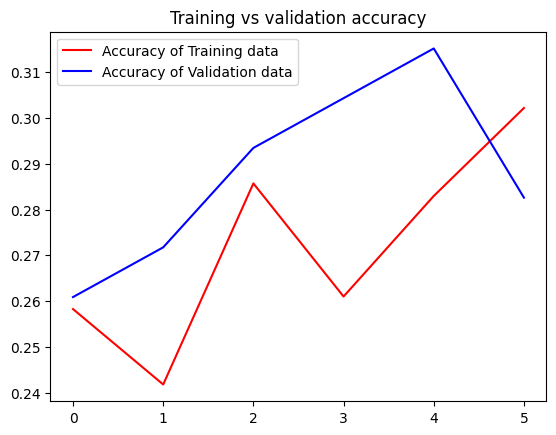

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(acc))
plt.plot(epochs, acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, val_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

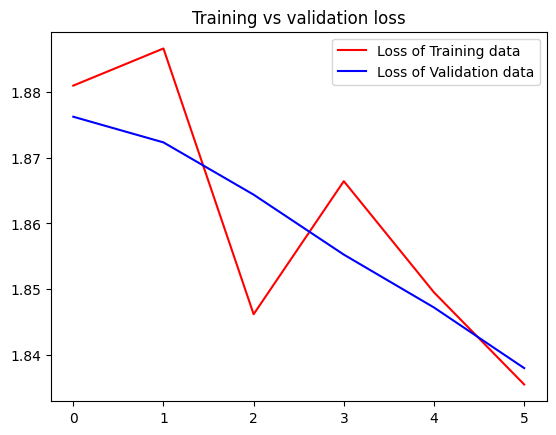

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(loss))
plt.plot(epochs, loss, 'r', label='Loss of Training data')
plt.plot(epochs, val_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

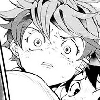

In [ ]:
load_img("/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/shock/001_481_386_212_212.png",target_size=(100,100))

In [ ]:
image=load_img("/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/shock/011_687_496_112_112.png",target_size=(100,100))

image=img_to_array(image)
image=image/255.0
prediction_image=np.array(image)
prediction_image= np.expand_dims(image, axis=0)

prediction=modelvgg.predict(prediction_image)
value=np.argmax(prediction)
move_name=mapper(value)
print("Prediction is {}.".format(move_name))

1/1 [==============================] - 0s 132ms/step
Prediction is shock.


ResNet

In [ ]:
pretrained_modelrn = tf.keras.applications.resnet_v2.ResNet50V2(
    include_top=False,
    weights='imagenet',
    input_tensor=None,
    input_shape=(100,100,3),
    pooling='avg',
    classes=1000,
    classifier_activation='softmax'
)

pretrained_modelrn.trainable = False

94668760/94668760 [==============================] - 1s 0us/step


In [ ]:
inputs3 = pretrained_modelrn.input
x3 = tf.keras.layers.Dense(128, activation='relu')(pretrained_modelrn.output)
outputs3 = tf.keras.layers.Dense(7, activation='softmax')(x3)
modelrn = tf.keras.Model(inputs=inputs3, outputs=outputs3)

modelrn.compile(optimizer='adam',loss='categorical_crossentropy',metrics=['accuracy'])

modelrn.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 100, 100, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 106, 106, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 50, 50, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 pool1_pad (ZeroPadding2D)      (None, 52, 52, 64)   0           ['conv1_conv[0][0]']         

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

# Custom variable to track the best validation loss
best_val_lossrn = float('inf')

# Initialize lists to store timestamps and corresponding CPU usages
timestampsrn = []
cpu_usagesrn = []

# Init plot material
accrn = []
lossrn = []
val_accrn = []
val_lossrn = []

# Start the training timer
start_time = time.time()

for epoch in range(50):
  hisrn = modelrn.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  # Calculate CPU usage at the end of each epoch
  current_time = time.time()
  elapsed_time = current_time - start_time
  cpu_usagern = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  timestampsrn.append(elapsed_time)
  cpu_usagesrn.append(cpu_usagern)

  # Track the best validation loss
  current_val_lossrn = hisrn.history['val_loss'][0]
  if current_val_lossrn < best_val_lossrn:
    best_val_lossrn = current_val_lossrn

  # Collect results for plot
  accrn.append(hisrn.history['accuracy'][0])
  val_accrn.append(hisrn.history['val_accuracy'][0])
  lossrn.append(hisrn.history['loss'][0])
  val_lossrn.append(hisrn.history['val_loss'][0])

  # Check for early stopping condition
  if epoch - early_stopping.patience >= early_stopping.stopped_epoch:
    print("Early stopping at epoch", epoch + 1)
    break

# End of training
print("Training completed.")

# Print the timestamps and CPU usages
for timestamprn, cpu_usagern in zip(timestampsrn, cpu_usagesrn):
    print(f"Time: {timestamprn:.2f}s, CPU Usage: {cpu_usagern:.2f}%")

Early stopping at epoch 6
Training completed.
Time: 45.56s, CPU Usage: 0.00%
Time: 65.10s, CPU Usage: 0.00%
Time: 106.38s, CPU Usage: 5.00%
Time: 147.66s, CPU Usage: 0.00%
Time: 188.95s, CPU Usage: 5.00%
Time: 210.62s, CPU Usage: 0.00%


In [ ]:
## ResNet50 - epochs = 30
y_predrn=modelrn.predict(testx)
predrn=np.argmax(y_predrn,axis=1)
groundrn = np.argmax(testy,axis=1)
print(classification_report(groundrn,predrn))

3/3 [==============================] - 7s 2s/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        10
           1       0.00      0.00      0.00         7
           2       0.20      1.00      0.33        18
           3       0.00      0.00      0.00        12
           4       0.00      0.00      0.00        11
           5       0.00      0.00      0.00        21
           6       0.00      0.00      0.00        13

    accuracy                           0.20        92
   macro avg       0.03      0.14      0.05        92
weighted avg       0.04      0.20      0.06        92



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


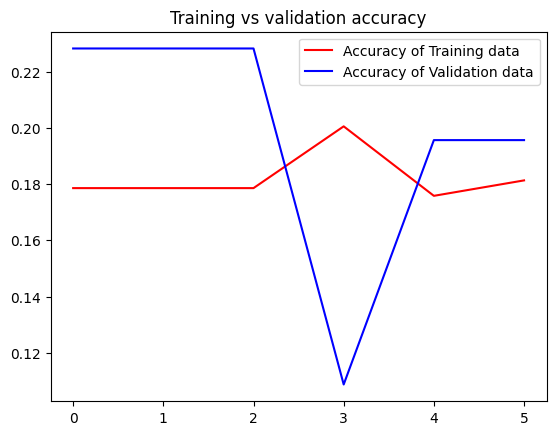

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(accrn))
plt.plot(epochs, accrn, 'r', label='Accuracy of Training data')
plt.plot(epochs, val_accrn, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

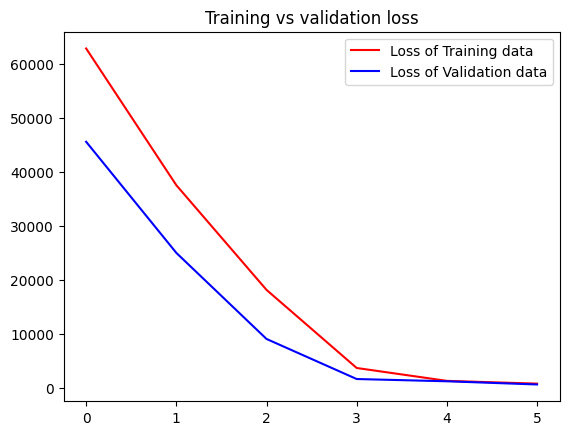

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(lossrn))
plt.plot(epochs, lossrn, 'r', label='Loss of Training data')
plt.plot(epochs, val_lossrn, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

GoogleNet https://medium.com/mlearning-ai/implementation-of-googlenet-on-keras-d9873aeed83c

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, concatenate, AveragePooling2D, Input

# Define the Inception module
def inception_module(x, filters):
    tower_1 = Conv2D(filters[0], (1, 1), padding='same', activation='relu')(x)
    tower_1 = Conv2D(filters[1], (3, 3), padding='same', activation='relu')(tower_1)

    tower_2 = Conv2D(filters[2], (1, 1), padding='same', activation='relu')(x)
    tower_2 = Conv2D(filters[3], (5, 5), padding='same', activation='relu')(tower_2)

    tower_3 = MaxPooling2D((3, 3), strides=(1, 1), padding='same')(x)
    tower_3 = Conv2D(filters[4], (1, 1), padding='same', activation='relu')(tower_3)

    tower_4 = Conv2D(filters[5], (1, 1), padding='same', activation='relu')(x)

    # Concatenate the outputs of all branches
    output = concatenate([tower_1, tower_2, tower_3, tower_4], axis=-1)
    return output

# Build the GoogleNet architecture
def googlenet(input_shape, num_classes):
    input_layer = Input(shape=input_shape)

    x = Conv2D(64, (7, 7), strides=(2, 2), padding='same', activation='relu')(input_layer)
    x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)

    x = Conv2D(64, (1, 1), padding='same', activation='relu')(x)
    x = Conv2D(192, (3, 3), padding='same', activation='relu')(x)
    x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)

    # First Inception module
    x = inception_module(x, [64, 128, 128, 192, 32, 32])
    x = inception_module(x, [128, 192, 96, 208, 16, 48])

    x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)

    # Second Inception module
    x = inception_module(x, [192, 208, 48, 64, 112, 24])
    x = inception_module(x, [160, 224, 64, 64, 128, 24])
    x = inception_module(x, [128, 256, 64, 64, 112, 24])
    x = inception_module(x, [112, 288, 64, 64, 128, 32])

    # Third Inception module
    x = inception_module(x, [256, 320, 128, 128, 128, 32])
    x = MaxPooling2D((3, 3), strides=(2, 2), padding='same')(x)

    # Flatten and add fully connected layers
    x = Flatten()(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.5)(x)

    x = Dense(num_classes, activation='softmax')(x)

    model = tf.keras.Model(inputs=input_layer, outputs=x)

    return model

In [ ]:
input_shape = (100, 100, 3)  # Adjust input shape to 100x100x3 for your dataset
num_classes = 7  # Adjust the number of output classes for your specific task
modelgg = googlenet(input_shape, num_classes)
modelgg.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 100, 100, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 50, 50, 64)   9472        ['input_3[0][0]']                
                                                                                                  
 max_pooling2d_3 (MaxPooling2D)  (None, 25, 25, 64)  0           ['conv2d[0][0]']                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 25, 25, 64)   4160        ['max_pooling2d_3[0][0]']  

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

modelgg.compile(optimizer='adam',
                loss='binary_crossentropy',
                metrics = ['accuracy'])

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

# Custom variable to track the best validation loss
best_val_lossgg = float('inf')

# Initialize lists to store timestamps and corresponding CPU usages
timestampsgg = []
cpu_usagesgg = []

# Init plot material
accgg = []
lossgg = []
val_accgg = []
val_lossgg = []

# Start the training timer
start_time = time.time()

for epoch in range(50):
  hisgg = modelgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  # Calculate CPU usage at the end of each epoch
  current_time = time.time()
  elapsed_time = current_time - start_time
  cpu_usagegg = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  timestampsgg.append(elapsed_time)
  cpu_usagesgg.append(cpu_usagegg)

  # Track the best validation loss
  current_val_lossgg = hisgg.history['val_loss'][0]
  if current_val_lossgg < best_val_lossgg:
    best_val_lossgg = current_val_lossgg

  # Collect results for plot
  accgg.append(hisgg.history['accuracy'][0])
  val_accgg.append(hisgg.history['val_accuracy'][0])
  lossgg.append(hisgg.history['loss'][0])
  val_lossgg.append(hisgg.history['val_loss'][0])

  # Check for early stopping condition
  if epoch - early_stopping.patience >= early_stopping.stopped_epoch:
    print("Early stopping at epoch", epoch + 1)
    break

# End of training
print("Training completed.")

# Print the timestamps and CPU usages
for timestamp, cpu_usage in zip(timestampsgg, cpu_usagesgg):
    print(f"Time: {timestamp:.2f}s, CPU Usage: {cpu_usage:.2f}%")

NameError: name 'modelgg' is not defined

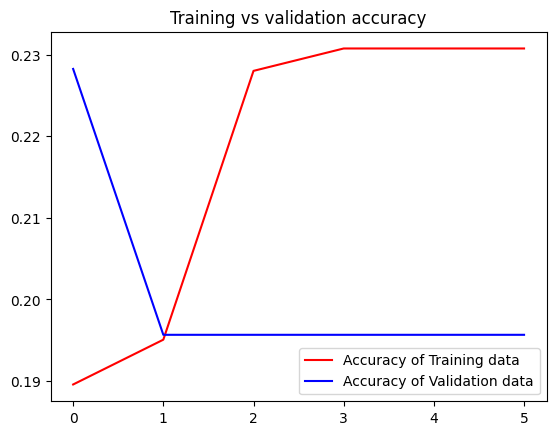

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(accgg))
plt.plot(epochs, accgg, 'r', label='Accuracy of Training data')
plt.plot(epochs, val_accgg, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

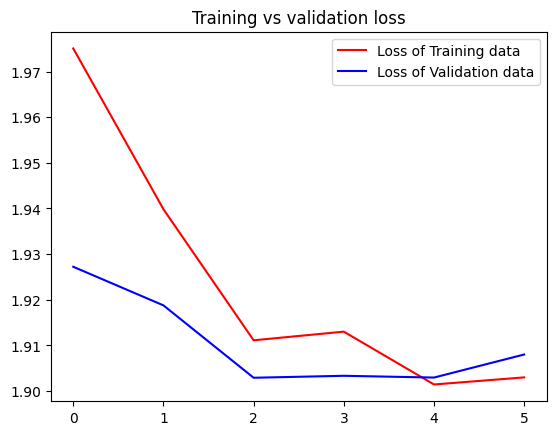

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(lossgg))
plt.plot(epochs, lossgg, 'r', label='Loss of Training data')
plt.plot(epochs, val_lossgg, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
## Googlenet
y_predgg=modelgg.predict(testx)
predgg=np.argmax(y_predgg,axis=1)
groundgg = np.argmax(testy,axis=1)
print(classification_report(groundgg,predgg))

3/3 [==============================] - 2s 629ms/step
              precision    recall  f1-score   support

           0       0.00      0.00      0.00        10
           1       0.00      0.00      0.00         7
           2       0.20      1.00      0.33        18
           3       0.00      0.00      0.00        12
           4       0.00      0.00      0.00        11
           5       0.00      0.00      0.00        21
           6       0.00      0.00      0.00        13

    accuracy                           0.20        92
   macro avg       0.03      0.14      0.05        92
weighted avg       0.04      0.20      0.06        92



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
cpu_vgg = []

for epoch in range(30):
  history30_vgg = modelvgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  cpu_vgg_current = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  cpu_vgg.append(cpu_vgg_current)

In [ ]:
cpu_rn = []
time_rn = []
start_time = time.time()
accrn30 = []
val_accrn30 = []
lossrn30 = []
val_lossrn30 = []

for epoch in range(30):
  history30_rn = modelrn.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  cpu_rn_current = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  cpu_rn.append(cpu_rn_current)

  current_time = time.time()
  elapsed_time = current_time - start_time
  time_rn.append(elapsed_time)

  accrn30.append(history30_rn.history['accuracy'][0])
  val_accrn30.append(history30_rn.history['val_accuracy'][0])
  lossrn30.append(history30_rn.history['loss'][0])
  val_lossrn30.append(history30_rn.history['val_loss'][0])

In [ ]:
cpu_gg = []

for epoch in range(30):
  history30_gg = modelgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  cpu_gg_current = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  cpu_gg.append(cpu_gg_current)

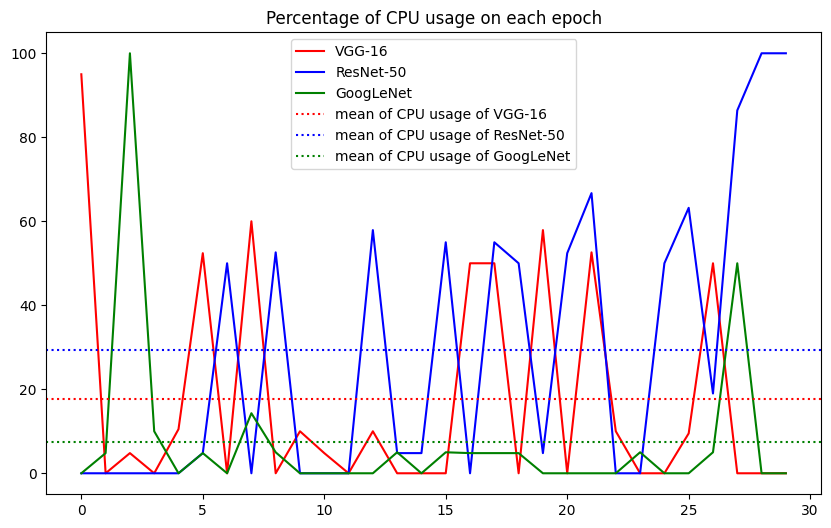

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(30)
plt.figure(figsize=(10, 6))
plt.plot(epochs, cpu_vgg, 'r', label='VGG-16')
plt.plot(epochs, cpu_rn, 'b', label='ResNet-50')
plt.plot(epochs, cpu_gg, 'g', label='GoogLeNet')
plt.axhline(y=np.mean(cpu_vgg), color='r', linestyle=':', label='mean of CPU usage of VGG-16')
plt.axhline(y=np.mean(cpu_rn), color='b', linestyle=':', label='mean of CPU usage of ResNet-50')
plt.axhline(y=np.mean(cpu_gg), color='g', linestyle=':', label='mean of CPU usage of GoogLeNet')
plt.title('Percentage of CPU usage on each epoch')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
time_vgg = []
start_time = time.time()

for epoch in range(30):
  history_vgg = modelvgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  # Calculate CPU usage at the end of each epoch
  current_time = time.time()
  elapsed_time = current_time - start_time
  time_vgg.append(elapsed_time)

In [ ]:
time_gg = []
start_time = time.time()

for epoch in range(30):
  history_gg = modelgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  # Calculate CPU usage at the end of each epoch
  current_time = time.time()
  elapsed_time = current_time - start_time
  time_gg.append(elapsed_time)

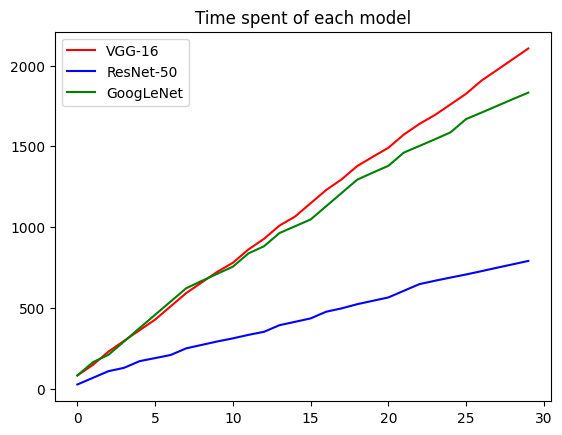

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(30)
plt.plot(epochs, time_vgg, 'r', label='VGG-16')
plt.plot(epochs, time_rn, 'b', label='ResNet-50')
plt.plot(epochs, time_gg, 'g', label='GoogLeNet')
plt.title('Time spent of each model')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
# Epochs 30
modelvgg.compile(optimizer=tf.keras.optimizers.Adam(),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

h30vgg = modelvgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=30,
                          validation_data=(testx,testy))

Epoch 1/30
12/12 [==============================] - 74s 6s/step - loss: 1.9977 - accuracy: 0.1703 - val_loss: 1.8935 - val_accuracy: 0.2065
Epoch 2/30
12/12 [==============================] - 51s 4s/step - loss: 1.8630 - accuracy: 0.2473 - val_loss: 1.8085 - val_accuracy: 0.2826
Epoch 3/30
12/12 [==============================] - 60s 5s/step - loss: 1.7995 - accuracy: 0.3022 - val_loss: 1.8166 - val_accuracy: 0.2391
Epoch 4/30
12/12 [==============================] - 59s 5s/step - loss: 1.7388 - accuracy: 0.3626 - val_loss: 1.7475 - val_accuracy: 0.3370
Epoch 5/30
12/12 [==============================] - 60s 5s/step - loss: 1.6748 - accuracy: 0.4011 - val_loss: 1.7345 - val_accuracy: 0.2935
Epoch 6/30
12/12 [==============================] - 60s 5s/step - loss: 1.6501 - accuracy: 0.3846 - val_loss: 1.7002 - val_accuracy: 0.3587
Epoch 7/30
12/12 [==============================] - 60s 5s/step - loss: 1.6098 - accuracy: 0.4066 - val_loss: 1.6860 - val_accuracy: 0.3587
Epoch 8/30
12/12 [==

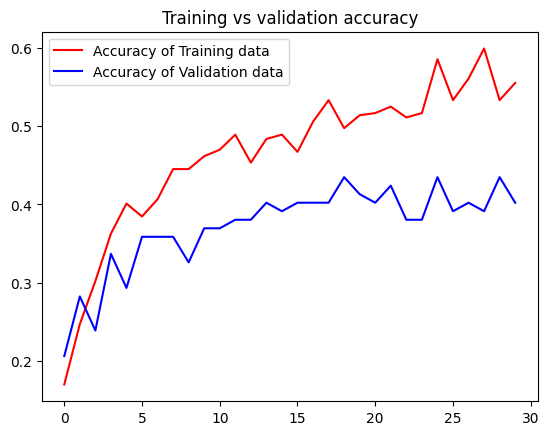

<Figure size 640x480 with 0 Axes>

In [ ]:
get_acc = h30vgg.history['accuracy']
value_acc = h30vgg.history['val_accuracy']
get_loss = h30vgg.history['loss']
validation_loss = h30vgg.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

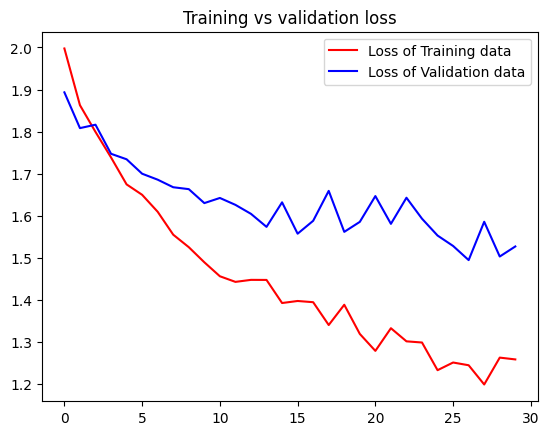

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
# Epochs 30 _ LR 0.0001
modelgg.compile(optimizer=tf.keras.optimizers.Adam(),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

h30gg = modelgg.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=30,
                    validation_data=(testx,testy))

Epoch 1/30
12/12 [==============================] - 82s 3s/step - loss: 1.9411 - accuracy: 0.2170 - val_loss: 1.9041 - val_accuracy: 0.1957
Epoch 2/30
12/12 [==============================] - 37s 3s/step - loss: 1.9185 - accuracy: 0.2115 - val_loss: 1.9038 - val_accuracy: 0.1957
Epoch 3/30
12/12 [==============================] - 39s 3s/step - loss: 1.9100 - accuracy: 0.1923 - val_loss: 1.9016 - val_accuracy: 0.1957
Epoch 4/30
12/12 [==============================] - 36s 3s/step - loss: 1.9035 - accuracy: 0.2363 - val_loss: 1.8990 - val_accuracy: 0.1957
Epoch 5/30
12/12 [==============================] - 38s 3s/step - loss: 1.9063 - accuracy: 0.2280 - val_loss: 1.9003 - val_accuracy: 0.1957
Epoch 6/30
12/12 [==============================] - 40s 3s/step - loss: 1.9005 - accuracy: 0.2308 - val_loss: 1.9044 - val_accuracy: 0.1957
Epoch 7/30
12/12 [==============================] - 36s 3s/step - loss: 1.9025 - accuracy: 0.2308 - val_loss: 1.9034 - val_accuracy: 0.1957
Epoch 8/30
12/12 [==

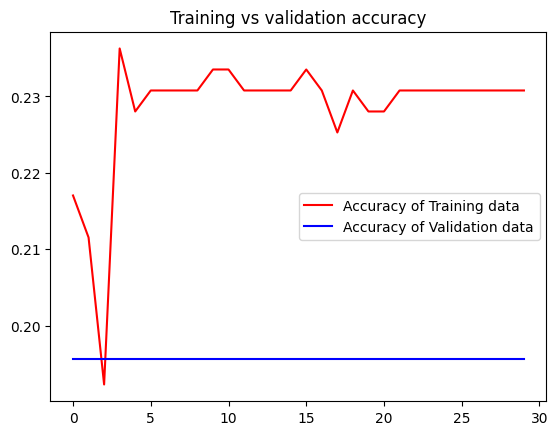

<Figure size 640x480 with 0 Axes>

In [ ]:
get_acc = h30gg.history['accuracy']
value_acc = h30gg.history['val_accuracy']
get_loss = h30gg.history['loss']
validation_loss = h30gg.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

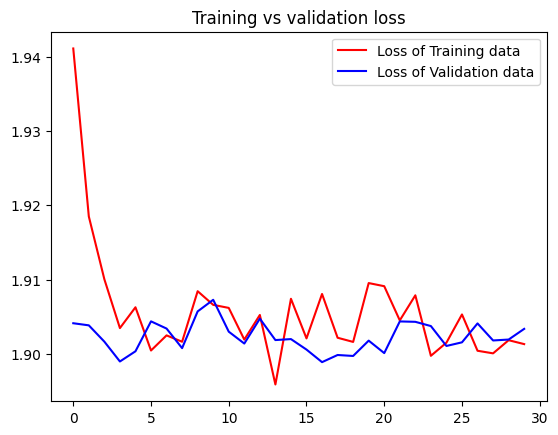

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
# Epochs 30 _ LRFingder 50
modelrn.compile(optimizer=tf.keras.optimizers.Adam(leaning_rate=100),
                loss = 'categorical_crossentropy',
                metrics = ['accuracy'])

h30rn = modelrn.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=30,
                    validation_data=(testx,testy))

Epoch 1/30
12/12 [==============================] - 16s 1s/step - loss: 2.2838 - accuracy: 0.2335 - val_loss: 1.7769 - val_accuracy: 0.3261
Epoch 2/30
12/12 [==============================] - 12s 973ms/step - loss: 1.7121 - accuracy: 0.3516 - val_loss: 1.7054 - val_accuracy: 0.3696
Epoch 3/30
12/12 [==============================] - 12s 973ms/step - loss: 1.6198 - accuracy: 0.4368 - val_loss: 1.6929 - val_accuracy: 0.4783
Epoch 4/30
12/12 [==============================] - 11s 974ms/step - loss: 1.5133 - accuracy: 0.4478 - val_loss: 1.6379 - val_accuracy: 0.5000
Epoch 5/30
12/12 [==============================] - 12s 1s/step - loss: 1.4692 - accuracy: 0.4863 - val_loss: 1.6189 - val_accuracy: 0.4348
Epoch 6/30
12/12 [==============================] - 12s 978ms/step - loss: 1.3485 - accuracy: 0.4863 - val_loss: 1.5256 - val_accuracy: 0.4891
Epoch 7/30
12/12 [==============================] - 12s 975ms/step - loss: 1.3284 - accuracy: 0.5082 - val_loss: 1.5320 - val_accuracy: 0.4565
Epoch

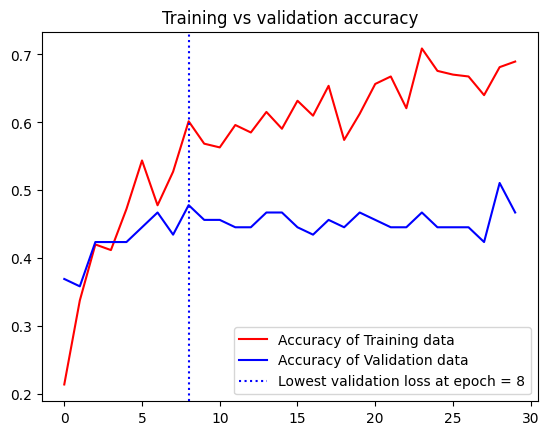

<Figure size 640x480 with 0 Axes>

In [ ]:
get_acc = h30rn.history['accuracy']
value_acc = h30rn.history['val_accuracy']
get_loss = h30rn.history['loss']
validation_loss = h30rn.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.axvline(x = 8, color = 'b', linestyle=':', label = 'Lowest validation loss at epoch = 8')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

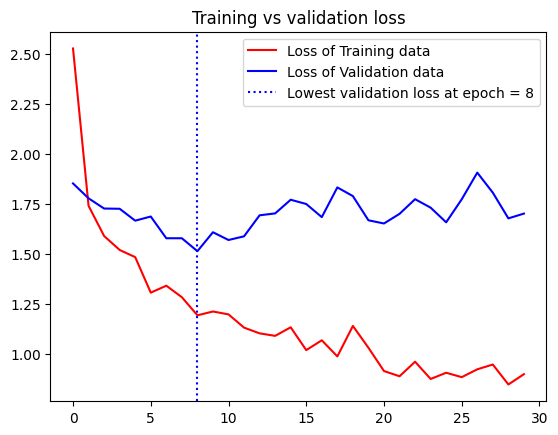

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.axvline(x = 8, color = 'b', linestyle=':', label = 'Lowest validation loss at epoch = 8')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
# Epochs es _ LR 0.0001
from tensorflow.keras.callbacks import EarlyStopping

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

hrnes = modelrn.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=30,
                    validation_data=(testx,testy), callbacks=[early_stopping])

Epoch 1/30
12/12 [==============================] - 23s 2s/step - loss: 0.8003 - accuracy: 0.7280 - val_loss: 1.6916 - val_accuracy: 0.4891
Epoch 2/30
12/12 [==============================] - 19s 2s/step - loss: 0.7611 - accuracy: 0.7253 - val_loss: 1.7429 - val_accuracy: 0.5000
Epoch 3/30
12/12 [==============================] - 19s 2s/step - loss: 0.7571 - accuracy: 0.7253 - val_loss: 1.8242 - val_accuracy: 0.4674
Epoch 4/30
12/12 [==============================] - 19s 2s/step - loss: 0.8307 - accuracy: 0.7225 - val_loss: 1.8640 - val_accuracy: 0.4130
Epoch 5/30
12/12 [==============================] - 19s 2s/step - loss: 0.9258 - accuracy: 0.6621 - val_loss: 1.7814 - val_accuracy: 0.5109
Epoch 6/30
12/12 [==============================] - 18s 2s/step - loss: 0.8010 - accuracy: 0.6951 - val_loss: 1.8069 - val_accuracy: 0.4891
Epoch 7/30
12/12 [==============================] - 19s 2s/step - loss: 0.8623 - accuracy: 0.6978 - val_loss: 1.7813 - val_accuracy: 0.4348
Epoch 8/30
12/12 [==

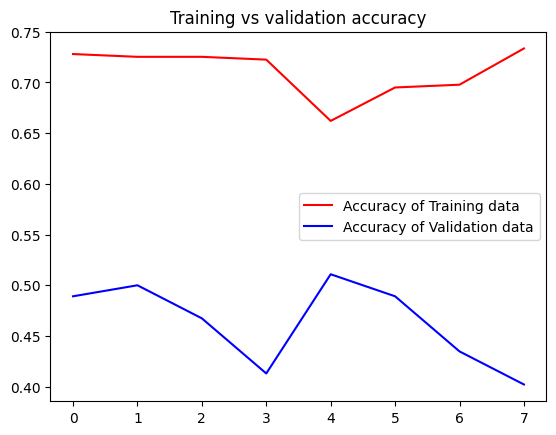

<Figure size 640x480 with 0 Axes>

In [ ]:
get_acc = hrnes.history['accuracy']
value_acc = hrnes.history['val_accuracy']
get_loss = hrnes.history['loss']
validation_loss = hrnes.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

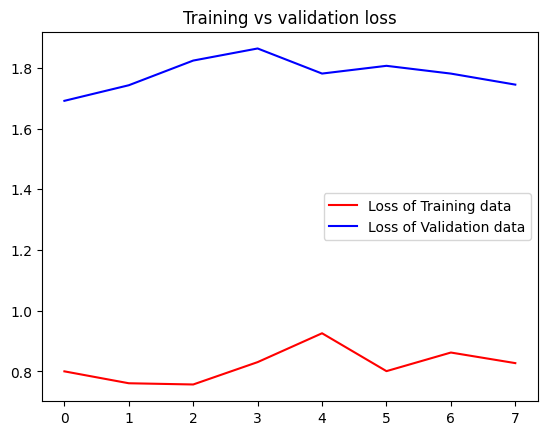

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

https://www.kaggle.com/code/paultimothymooney/learning-rate-finder-for-keras

In [ ]:
import math
from keras.callbacks import LambdaCallback
import keras.backend as K


class LRFinder:
    """
    Plots the change of the loss function of a Keras model when the learning rate is exponentially increasing.
    See for details:
    https://towardsdatascience.com/estimating-optimal-learning-rate-for-a-deep-neural-network-ce32f2556ce0
    """
    def __init__(self, model):
        self.model = model
        self.losses = []
        self.lrs = []
        self.best_loss = 1e9

    def on_batch_end(self, batch, logs):
        # Log the learning rate
        lr = K.get_value(self.model.optimizer.lr)
        self.lrs.append(lr)

        # Log the loss
        loss = logs['loss']
        self.losses.append(loss)

        # Check whether the loss got too large or NaN
        if math.isnan(loss) or loss > self.best_loss * 4:
            self.model.stop_training = True
            return

        if loss < self.best_loss:
            self.best_loss = loss

        # Increase the learning rate for the next batch
        lr *= self.lr_mult
        K.set_value(self.model.optimizer.lr, lr)

    def find(self, x_train, y_train, start_lr, end_lr, batch_size=64, epochs=1):
        num_batches = epochs * x_train.shape[0] / batch_size
        self.lr_mult = (end_lr / start_lr) ** (1 / num_batches)

        # Save weights into a file
        self.model.save_weights('tmp.h5')

        # Remember the original learning rate
        original_lr = K.get_value(self.model.optimizer.lr)

        # Set the initial learning rate
        K.set_value(self.model.optimizer.lr, start_lr)

        callback = LambdaCallback(on_batch_end=lambda batch, logs: self.on_batch_end(batch, logs))

        self.model.fit(x_train, y_train,
                        batch_size=batch_size, epochs=epochs,
                        callbacks=[callback])

        # Restore the weights to the state before model fitting
        self.model.load_weights('tmp.h5')

        # Restore the original learning rate
        K.set_value(self.model.optimizer.lr, original_lr)

    def plot_loss(self, n_skip_beginning=10, n_skip_end=5):
        """
        Plots the loss.
        Parameters:
            n_skip_beginning - number of batches to skip on the left.
            n_skip_end - number of batches to skip on the right.
        """
        plt.ylabel("loss")
        plt.xlabel("learning rate (log scale)")
        plt.plot(self.lrs[n_skip_beginning:-n_skip_end], self.losses[n_skip_beginning:-n_skip_end], color = 'r')
        plt.axvline(x = self.lrs[np.argmin(self.losses[5:-5])], color = 'b', linestyle=':', label = 'Optimal LR')
        plt.xscale('log')
        print("Best Learning Rate:", self.lrs[np.argmin(self.losses[5:-5])])

    def plot_loss_change(self, sma=1, n_skip_beginning=10, n_skip_end=5, y_lim=(-0.01, 0.01)):
        """
        Plots rate of change of the loss function.
        Parameters:
            sma - number of batches for simple moving average to smooth out the curve.
            n_skip_beginning - number of batches to skip on the left.
            n_skip_end - number of batches to skip on the right.
            y_lim - limits for the y axis.
        """
        assert sma >= 1
        derivatives = [0] * sma
        for i in range(sma, len(self.lrs)):
            derivative = (self.losses[i] - self.losses[i - sma]) / sma
            derivatives.append(derivative)

        plt.ylabel("rate of loss change")
        plt.xlabel("learning rate (log scale)")
        plt.plot(self.lrs[n_skip_beginning:-n_skip_end], derivatives[n_skip_beginning:-n_skip_end], color = 'r')
        plt.xscale('log')
        plt.ylim(y_lim)

Epoch 1/5
12/12 [==============================] - 18s 1s/step - loss: 2.2715 - accuracy: 0.2198
Epoch 2/5
12/12 [==============================] - 14s 1s/step - loss: 1.4590 - accuracy: 0.5137
Epoch 3/5
12/12 [==============================] - 13s 1s/step - loss: 2.7309 - accuracy: 0.5247
Epoch 4/5
12/12 [==============================] - 1s 767us/step - loss: 8.5439 - accuracy: 0.2500
Best Learning Rate: 0.005731149


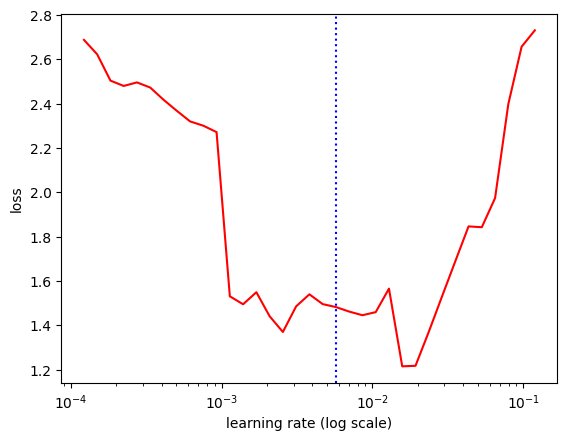

In [ ]:
lr_finder = LRFinder(modelrn)
lr_finder.find(trainx,trainy, start_lr=0.0001, end_lr=10, batch_size=32, epochs=5)
lr_finder.plot_loss(n_skip_beginning=1, n_skip_end=1)
plt.show()

https://www.jeremyjordan.me/nn-learning-rate/
-----
https://gist.github.com/jeremyjordan/ac0229abd4b2b7000aca1643e88e0f02

In [ ]:
import matplotlib.pyplot as plt
import keras.backend as K
from keras.callbacks import Callback


class LRFinder(Callback):

    '''
    A simple callback for finding the optimal learning rate range for your model + dataset.

    # Usage
        ```python
            lr_finder = LRFinder(min_lr=1e-5,
                                 max_lr=1e-2,
                                 steps_per_epoch=np.ceil(epoch_size/batch_size),
                                 epochs=3)
            model.fit(X_train, Y_train, callbacks=[lr_finder])

            lr_finder.plot_loss()
        ```

    # Arguments
        min_lr: The lower bound of the learning rate range for the experiment.
        max_lr: The upper bound of the learning rate range for the experiment.
        steps_per_epoch: Number of mini-batches in the dataset. Calculated as `np.ceil(epoch_size/batch_size)`.
        epochs: Number of epochs to run experiment. Usually between 2 and 4 epochs is sufficient.

    # References
        Blog post: jeremyjordan.me/nn-learning-rate
        Original paper: https://arxiv.org/abs/1506.01186
    '''

    def __init__(self, min_lr=1e-5, max_lr=1e-2, steps_per_epoch=None, epochs=None):
        super().__init__()

        self.min_lr = min_lr
        self.max_lr = max_lr
        self.total_iterations = steps_per_epoch * epochs
        self.iteration = 0
        self.history = {}

    def clr(self):
        '''Calculate the learning rate.'''
        x = self.iteration / self.total_iterations
        return self.min_lr + (self.max_lr-self.min_lr) * x

    def on_train_begin(self, logs=None):
        '''Initialize the learning rate to the minimum value at the start of training.'''
        logs = logs or {}
        K.set_value(self.model.optimizer.lr, self.min_lr)

    def on_batch_end(self, epoch, logs=None):
        '''Record previous batch statistics and update the learning rate.'''
        logs = logs or {}
        self.iteration += 1

        self.history.setdefault('lr', []).append(K.get_value(self.model.optimizer.lr))
        self.history.setdefault('iterations', []).append(self.iteration)

        for k, v in logs.items():
            self.history.setdefault(k, []).append(v)

        K.set_value(self.model.optimizer.lr, self.clr())

    def plot_lr(self):
        '''Helper function to quickly inspect the learning rate schedule.'''
        plt.plot(self.history['iterations'], self.history['lr'])
        plt.yscale('log')
        plt.xlabel('Iteration')
        plt.ylabel('Learning rate')
        plt.show()

    def plot_loss(self):
        '''Helper function to quickly observe the learning rate experiment results.'''
        plt.plot(self.history['lr'], self.history['loss'])
        plt.xscale('log')
        plt.xlabel('Learning rate')
        plt.ylabel('Loss')
        plt.show()

Epoch 1/5
6/6 [==============================] - 15s 2s/step - loss: 2.2156 - accuracy: 0.2308
Epoch 2/5
6/6 [==============================] - 12s 2s/step - loss: 2.2043 - accuracy: 0.2308
Epoch 3/5
6/6 [==============================] - 13s 2s/step - loss: 2.1831 - accuracy: 0.2308
Epoch 4/5
6/6 [==============================] - 13s 2s/step - loss: 2.1551 - accuracy: 0.2308
Epoch 5/5
6/6 [==============================] - 13s 2s/step - loss: 2.1193 - accuracy: 0.2308


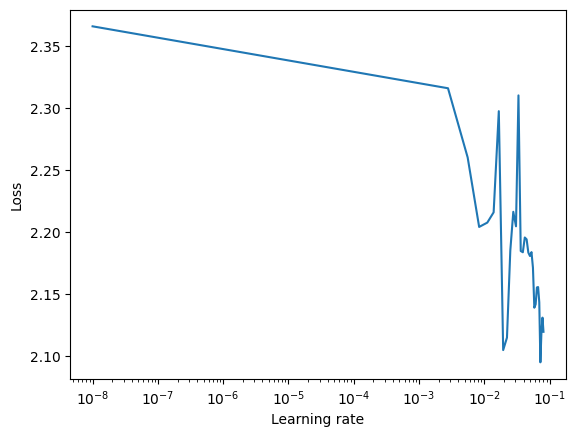

In [ ]:
lr_finder = LRFinder(min_lr=1e-8,
                     max_lr=1e-1,
                     steps_per_epoch=np.ceil(370/32),
                     epochs=3)

modelrn.fit(trainx, trainy, batch_size=64, epochs=5, callbacks=[lr_finder])

lr_finder.plot_loss()

In [ ]:
modelrn.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = 0.14616221),
                loss = tf.keras.losses.CategoricalCrossentropy(),
                metrics = ['accuracy'])

hrnlr = modelrn.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=30,
                    validation_data=(testx,testy))

Epoch 1/30
12/12 [==============================] - 36s 2s/step - loss: 1.9468 - accuracy: 0.2060 - val_loss: 1.9138 - val_accuracy: 0.1957
Epoch 2/30
12/12 [==============================] - 21s 2s/step - loss: 1.9073 - accuracy: 0.2308 - val_loss: 1.9186 - val_accuracy: 0.1957
Epoch 3/30
12/12 [==============================] - 22s 2s/step - loss: 1.9027 - accuracy: 0.2308 - val_loss: 1.8984 - val_accuracy: 0.1957
Epoch 4/30
12/12 [==============================] - 21s 2s/step - loss: 1.9272 - accuracy: 0.2005 - val_loss: 1.9018 - val_accuracy: 0.2283
Epoch 5/30
12/12 [==============================] - 21s 2s/step - loss: 1.9131 - accuracy: 0.2308 - val_loss: 1.9071 - val_accuracy: 0.1957
Epoch 6/30
12/12 [==============================] - 23s 2s/step - loss: 1.9076 - accuracy: 0.2308 - val_loss: 1.9117 - val_accuracy: 0.1957
Epoch 7/30
12/12 [==============================] - 21s 2s/step - loss: 2.0768 - accuracy: 0.1813 - val_loss: 1.9028 - val_accuracy: 0.2283
Epoch 8/30
12/12 [==

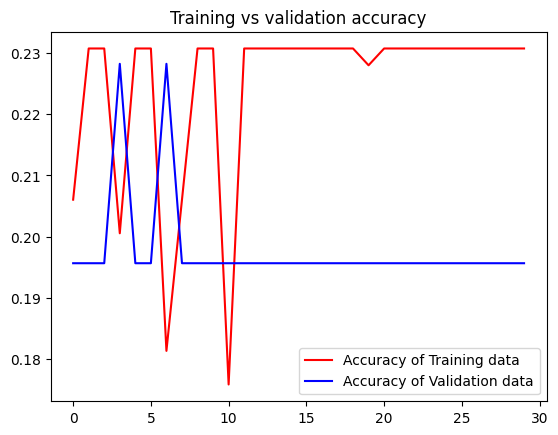

<Figure size 640x480 with 0 Axes>

In [ ]:
get_acc = hrnlr.history['accuracy']
value_acc = hrnlr.history['val_accuracy']
get_loss = hrnlr.history['loss']
validation_loss = hrnlr.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

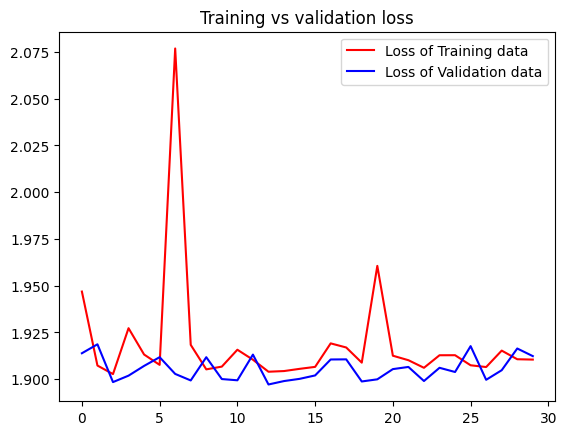

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
modelrn.compile(optimizer=tf.keras.optimizers.Adam(),
                loss = tf.keras.losses.CategoricalCrossentropy(),
                metrics = ['accuracy'])

hrnlr = modelrn.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=30,
                    validation_data=(testx,testy))

Epoch 1/30
12/12 [==============================] - 27s 2s/step - loss: 1.6310 - accuracy: 0.3626 - val_loss: 1.8732 - val_accuracy: 0.3370
Epoch 2/30
12/12 [==============================] - 23s 2s/step - loss: 1.5935 - accuracy: 0.4176 - val_loss: 1.8988 - val_accuracy: 0.3478
Epoch 3/30
12/12 [==============================] - 21s 2s/step - loss: 1.5260 - accuracy: 0.4093 - val_loss: 1.9110 - val_accuracy: 0.3478
Epoch 4/30
12/12 [==============================] - 20s 2s/step - loss: 1.5421 - accuracy: 0.3956 - val_loss: 1.9150 - val_accuracy: 0.3478
Epoch 5/30
12/12 [==============================] - 21s 2s/step - loss: 1.5559 - accuracy: 0.3791 - val_loss: 1.9327 - val_accuracy: 0.3478
Epoch 6/30
12/12 [==============================] - 19s 2s/step - loss: 1.6014 - accuracy: 0.4093 - val_loss: 1.9369 - val_accuracy: 0.3478
Epoch 7/30
12/12 [==============================] - 20s 2s/step - loss: 1.5343 - accuracy: 0.4093 - val_loss: 1.9482 - val_accuracy: 0.3478
Epoch 8/30
12/12 [==

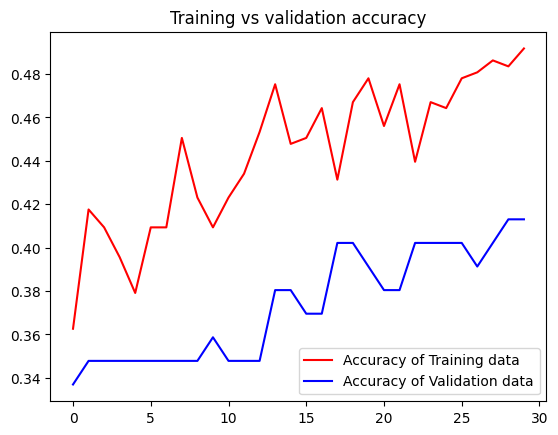

<Figure size 640x480 with 0 Axes>

In [ ]:
get_acc = hrnlr.history['accuracy']
value_acc = hrnlr.history['val_accuracy']
get_loss = hrnlr.history['loss']
validation_loss = hrnlr.history['val_loss']

epochs = range(len(get_acc))
plt.plot(epochs, get_acc, 'r', label='Accuracy of Training data')
plt.plot(epochs, value_acc, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

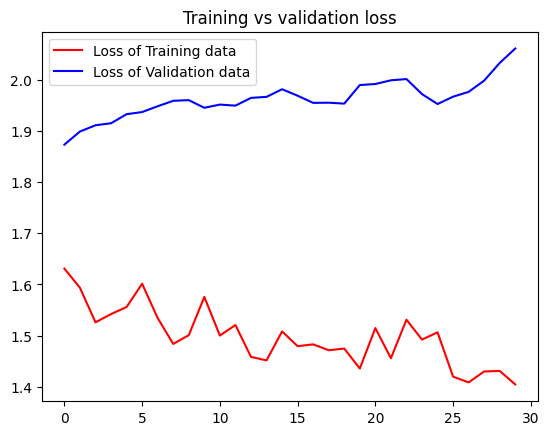

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(len(get_loss))
plt.plot(epochs, get_loss, 'r', label='Loss of Training data')
plt.plot(epochs, validation_loss, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

shock vs no-shock

In [ ]:
modelvgg.compile(optimizer='adam',
                loss = tf.keras.losses.CategoricalCrossentropy(),
                metrics = ['accuracy'])

histestvgg = modelvgg.fit(datagen.flow(trainx_shock,trainy_shock,batch_size=32), epochs=30,
                          validation_data=(testx_shock,testy_shock))

In [ ]:
y_predtestvgg=modelvgg.predict(testx_shock)
predtestvgg=np.argmax(y_predtestvgg,axis=1)
groundtestvgg = np.argmax(testy_shock,axis=1)
print(classification_report(groundtestvgg,predtestvgg))

1/1 [==============================] - 2s 2s/step
              precision    recall  f1-score   support

           2       1.00      0.81      0.89        21
           4       0.00      0.00      0.00         0

    accuracy                           0.81        21
   macro avg       0.50      0.40      0.45        21
weighted avg       1.00      0.81      0.89        21



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Activation maps

In [ ]:
pip install keract

input_1 (1, 100, 100, 3) 


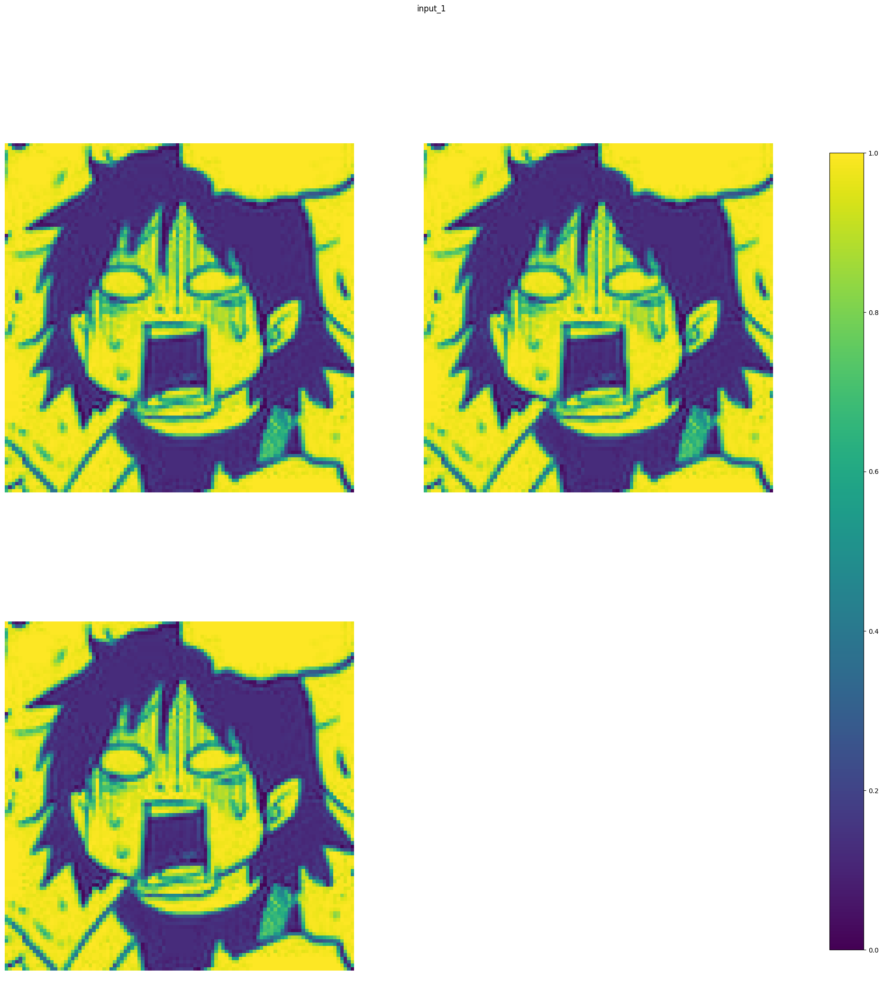

block1_conv1 (1, 100, 100, 64) 


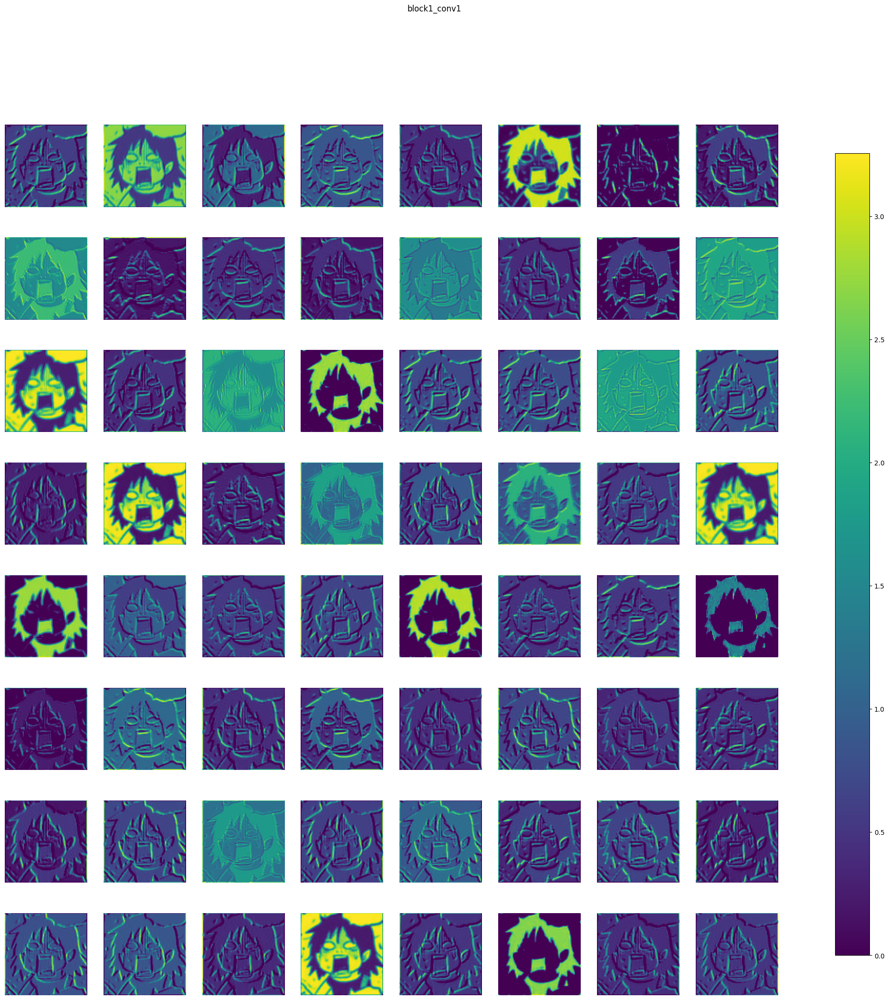

block1_conv2 (1, 100, 100, 64) 


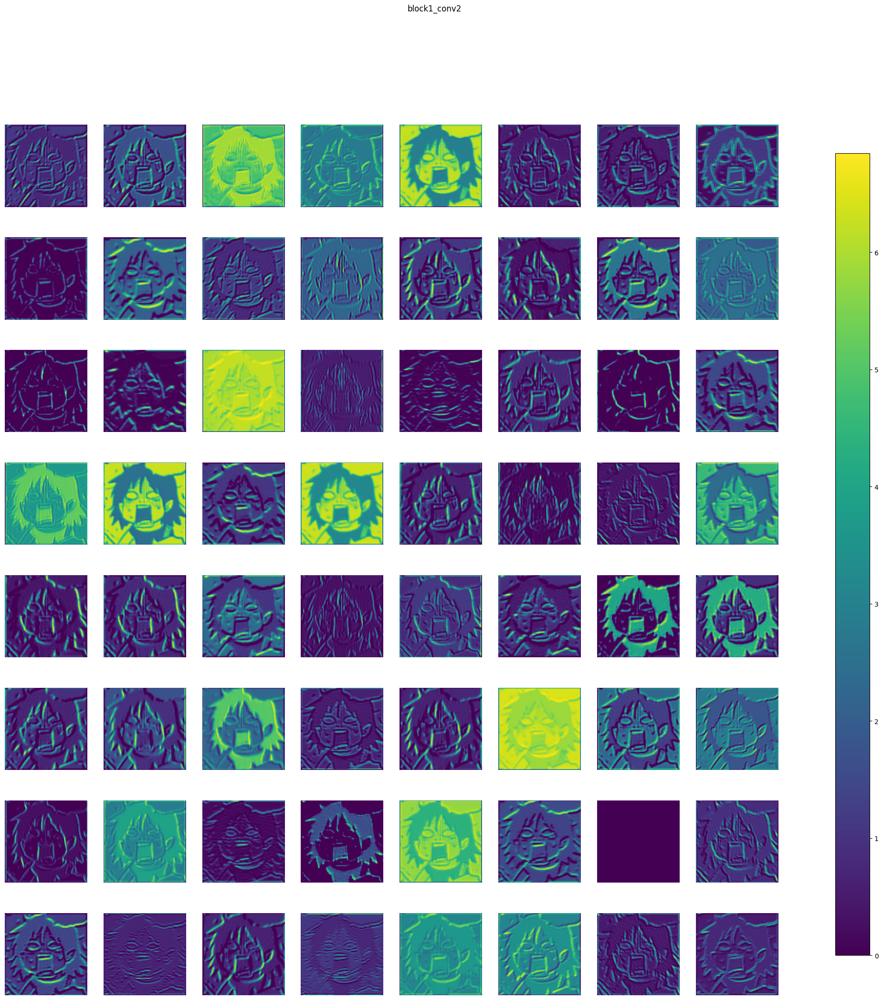

block1_pool (1, 50, 50, 64) 


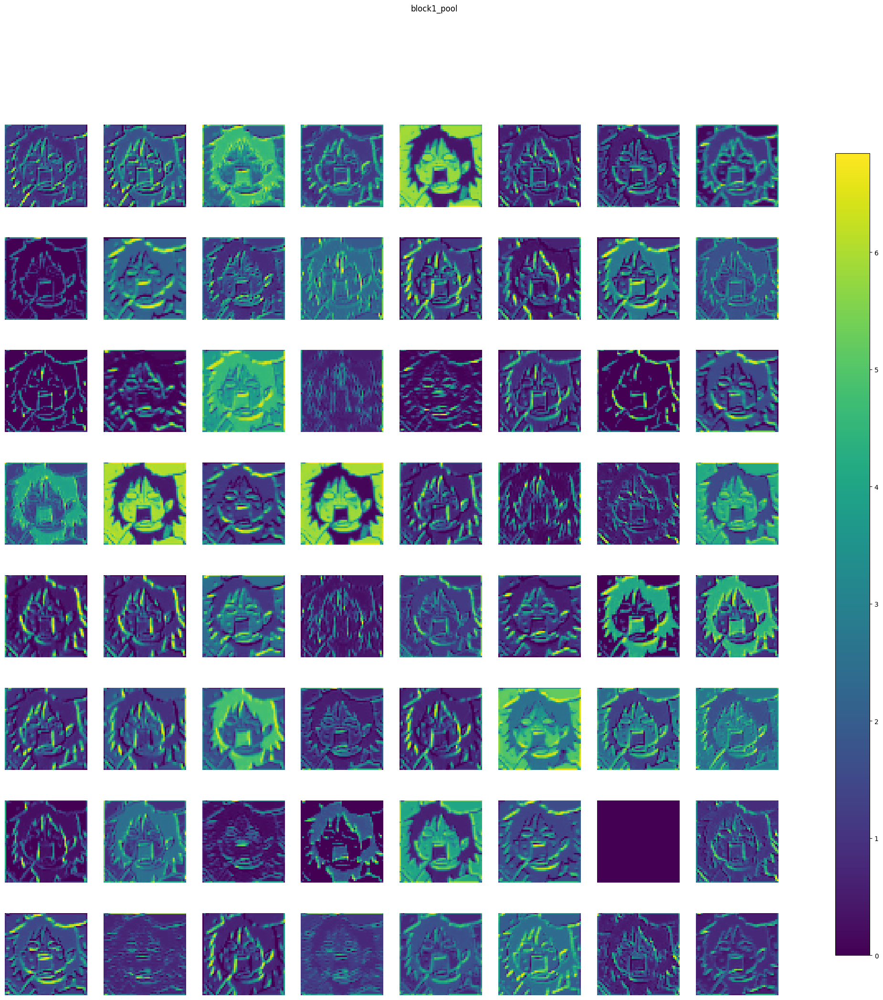

block2_conv1 (1, 50, 50, 128) 


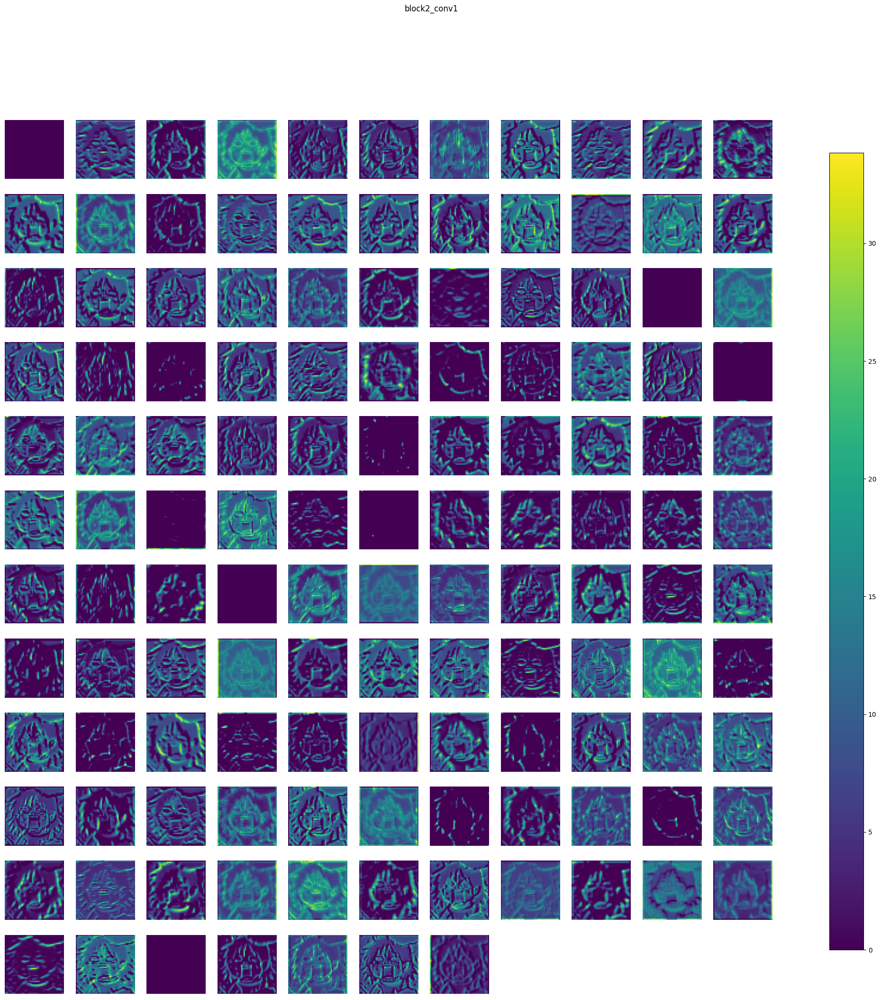

block2_conv2 (1, 50, 50, 128) 


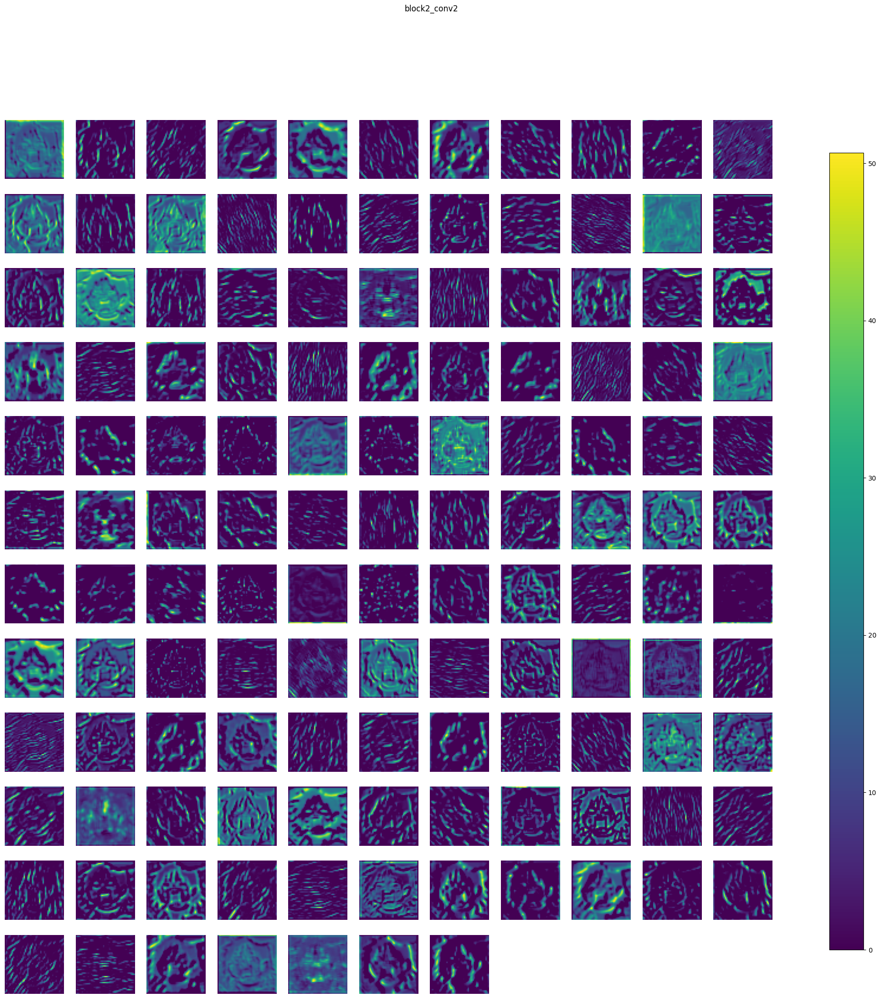

block2_pool (1, 25, 25, 128) 


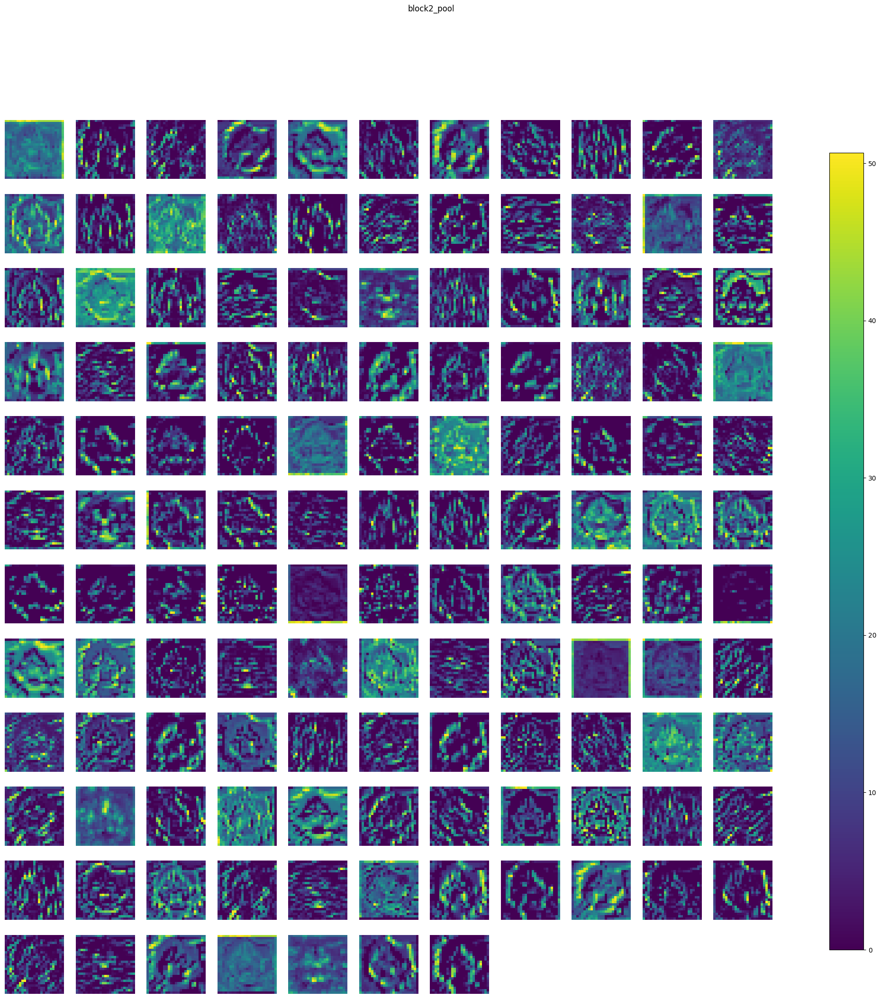

block3_conv1 (1, 25, 25, 256) 


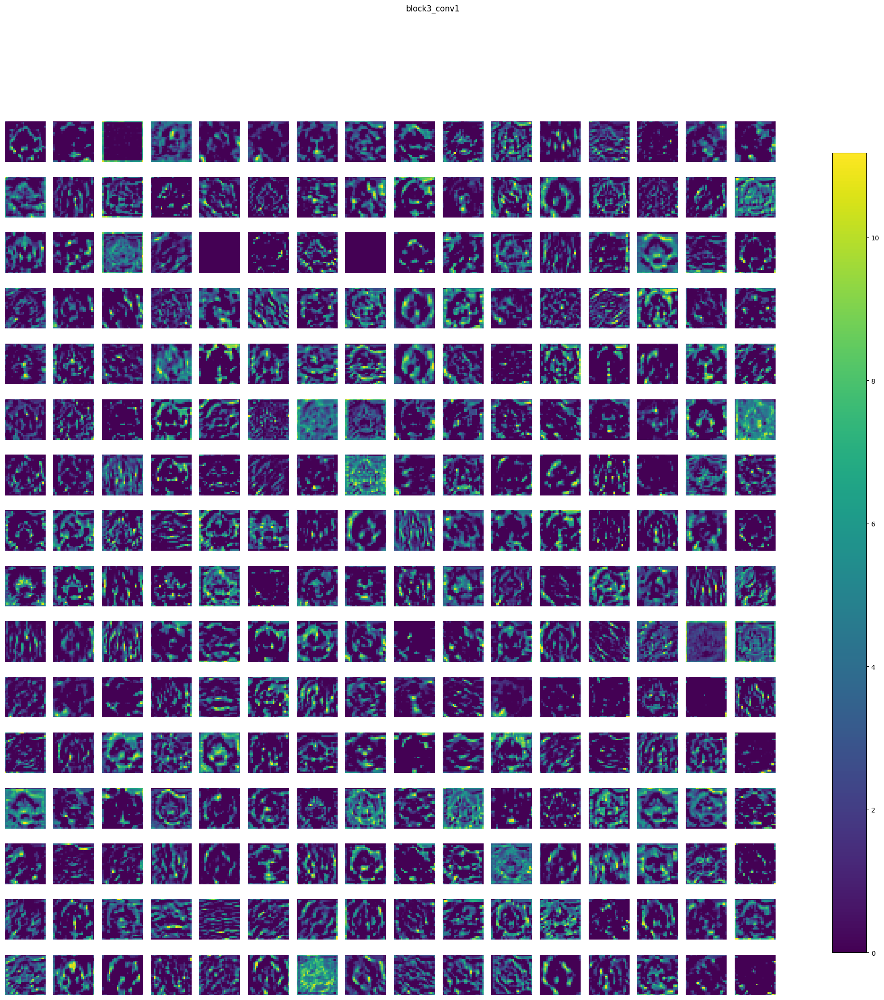

block3_conv2 (1, 25, 25, 256) 


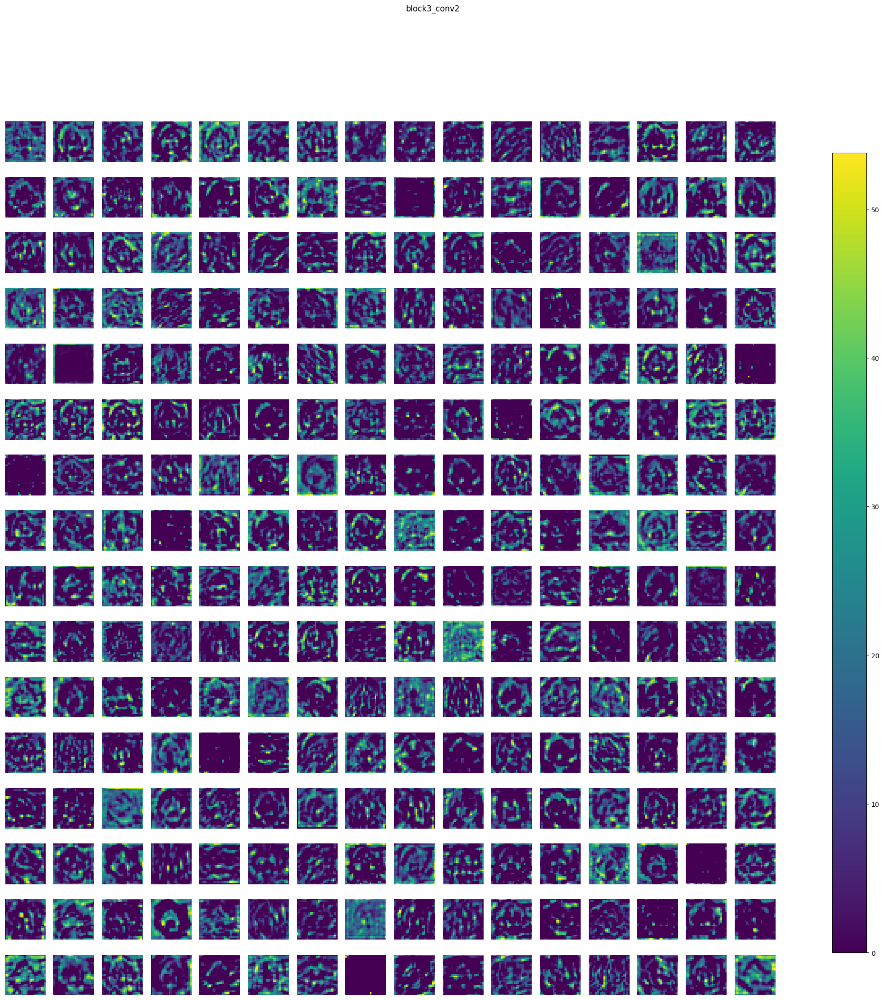

block3_conv3 (1, 25, 25, 256) 


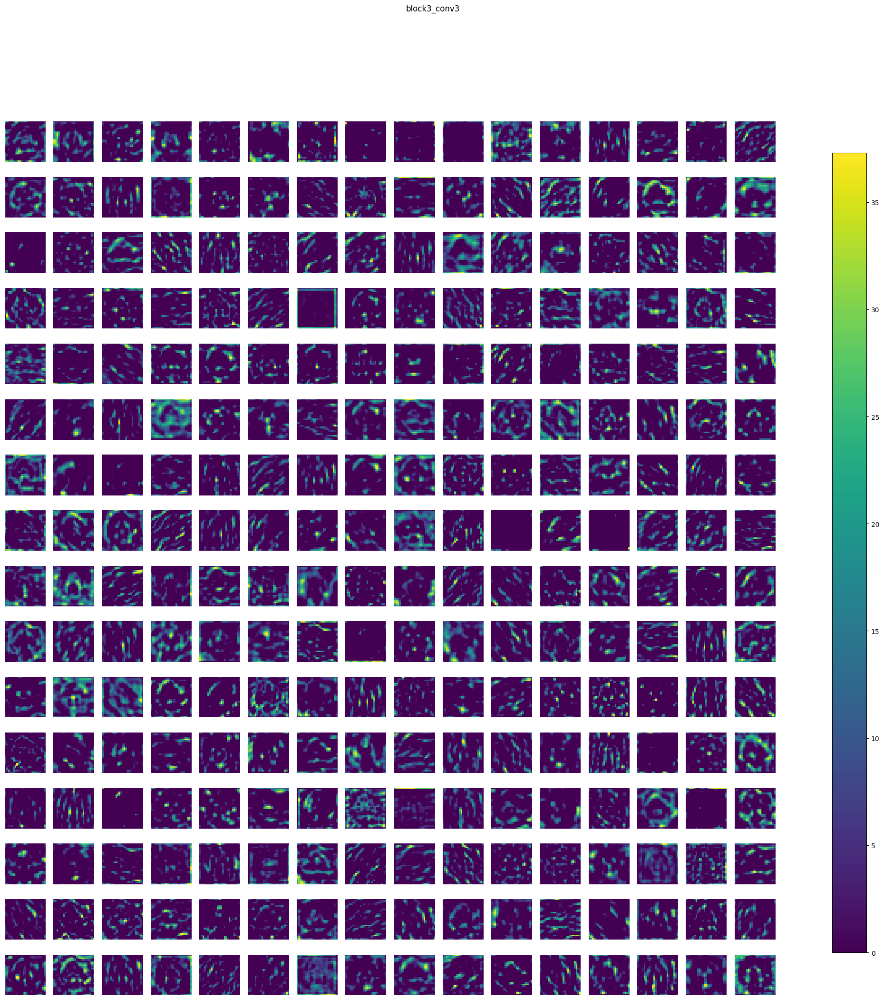

block3_pool (1, 12, 12, 256) 


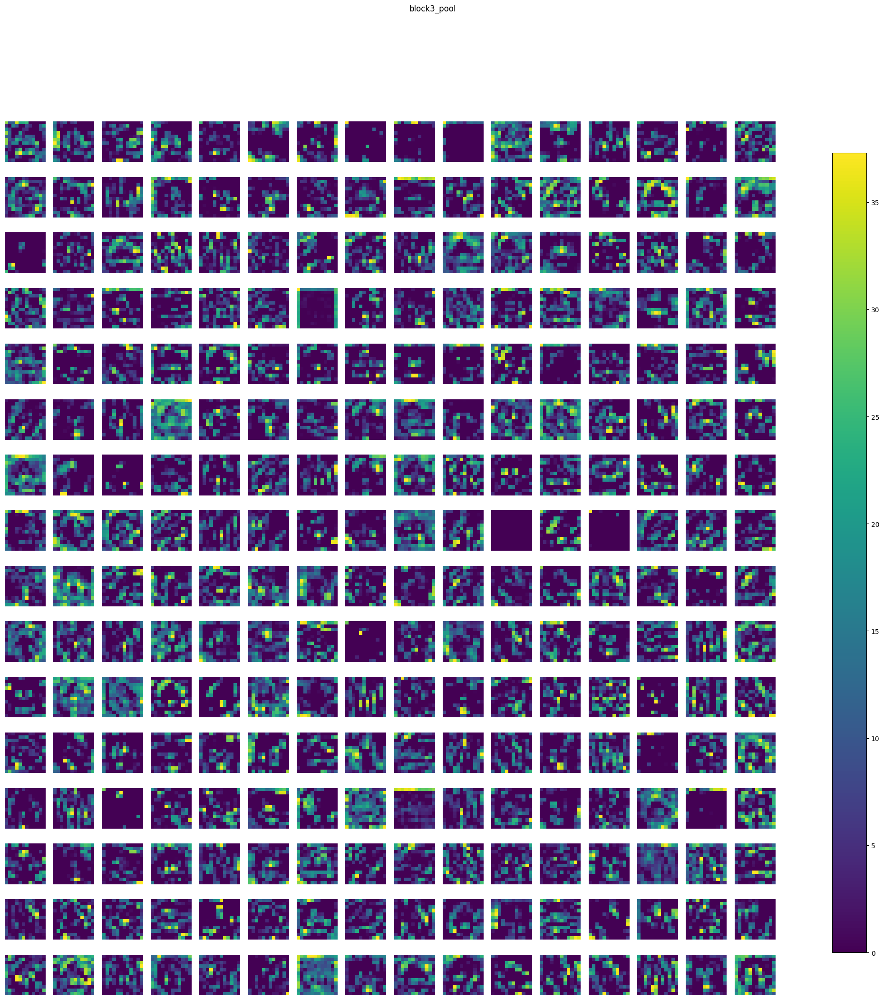

block4_conv1 (1, 12, 12, 512) 


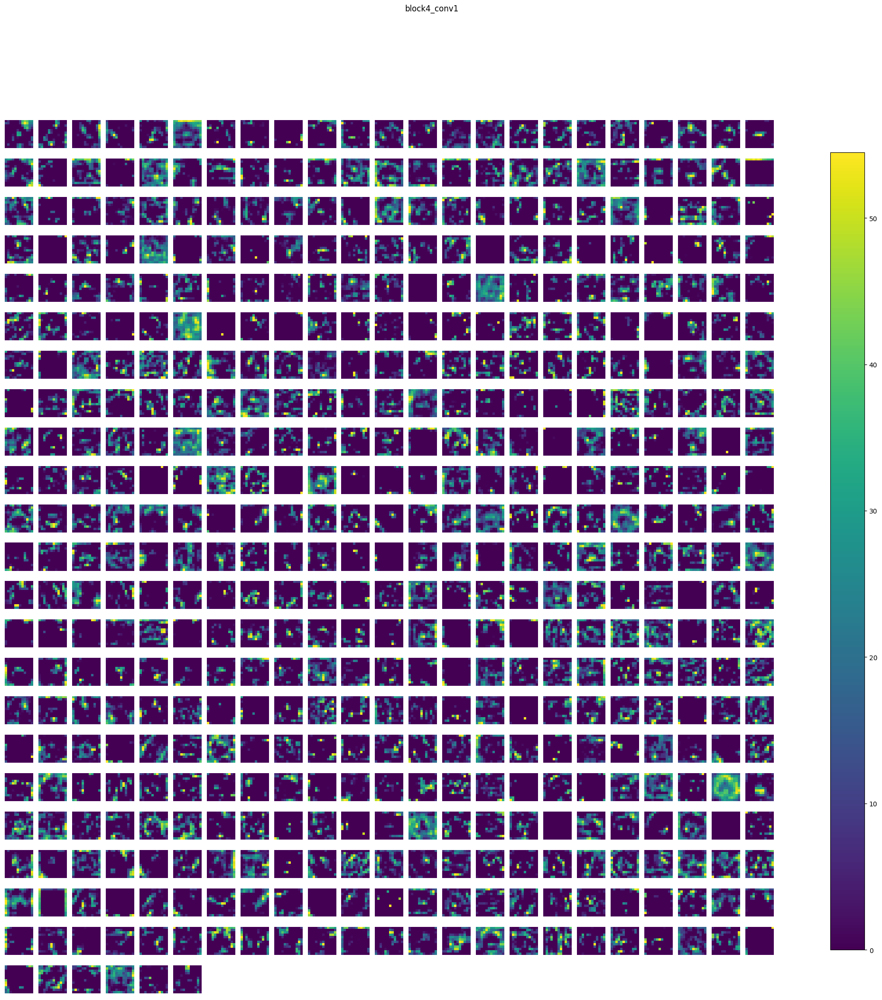

block4_conv2 (1, 12, 12, 512) 


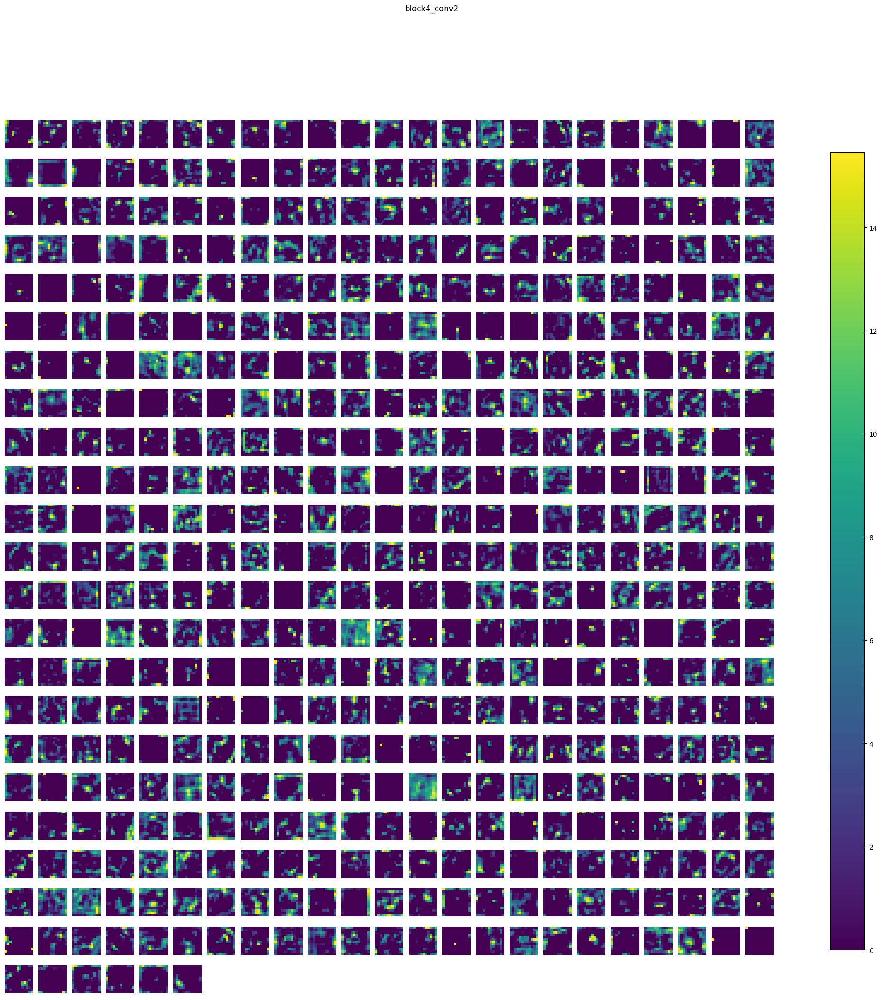

block4_conv3 (1, 12, 12, 512) 


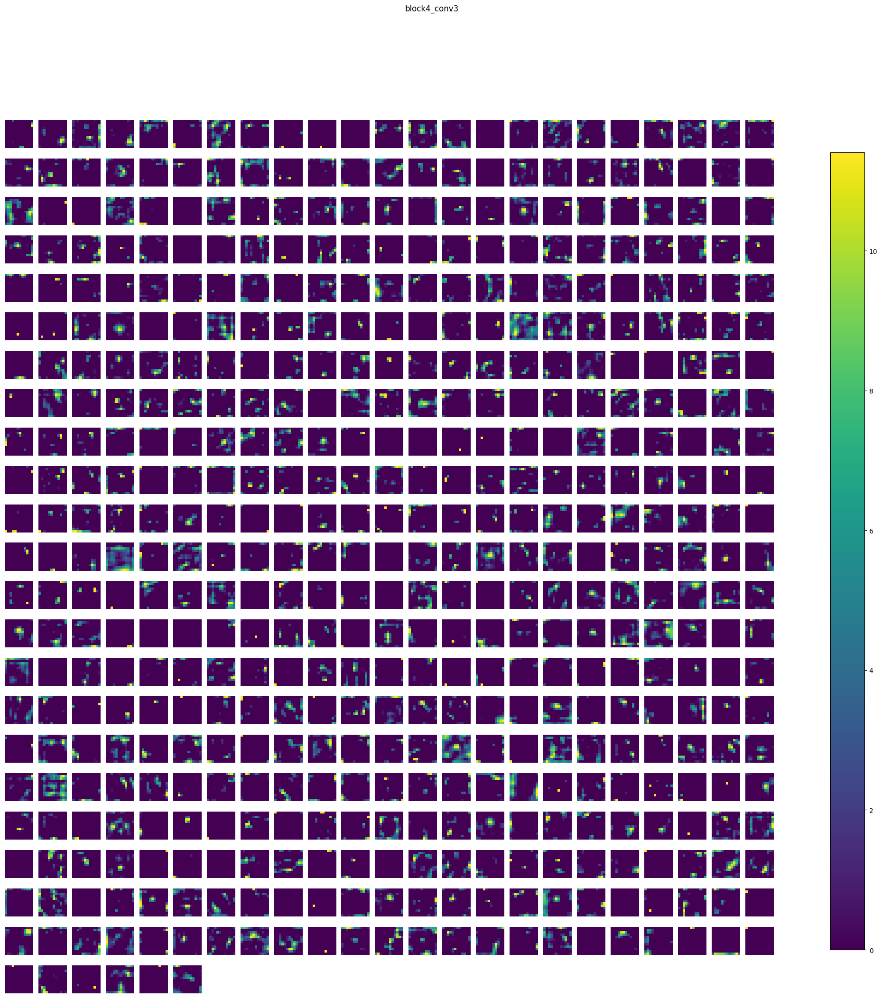

block4_pool (1, 6, 6, 512) 


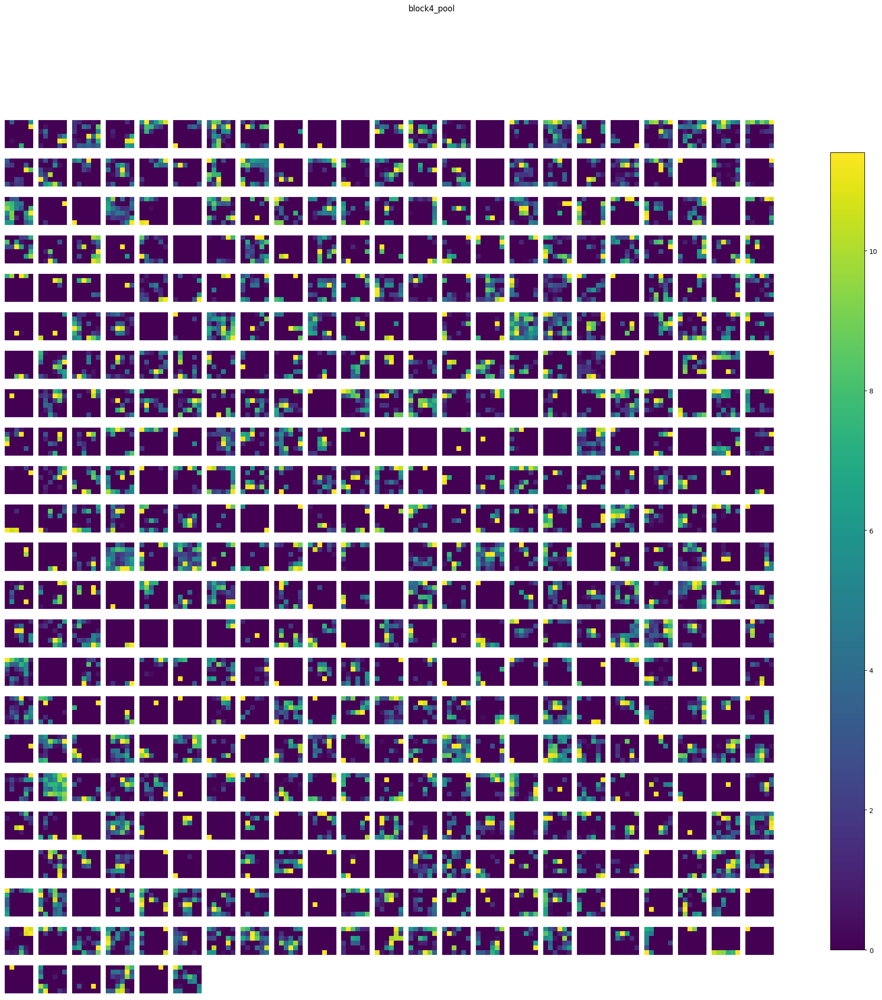

block5_conv1 (1, 6, 6, 512) 


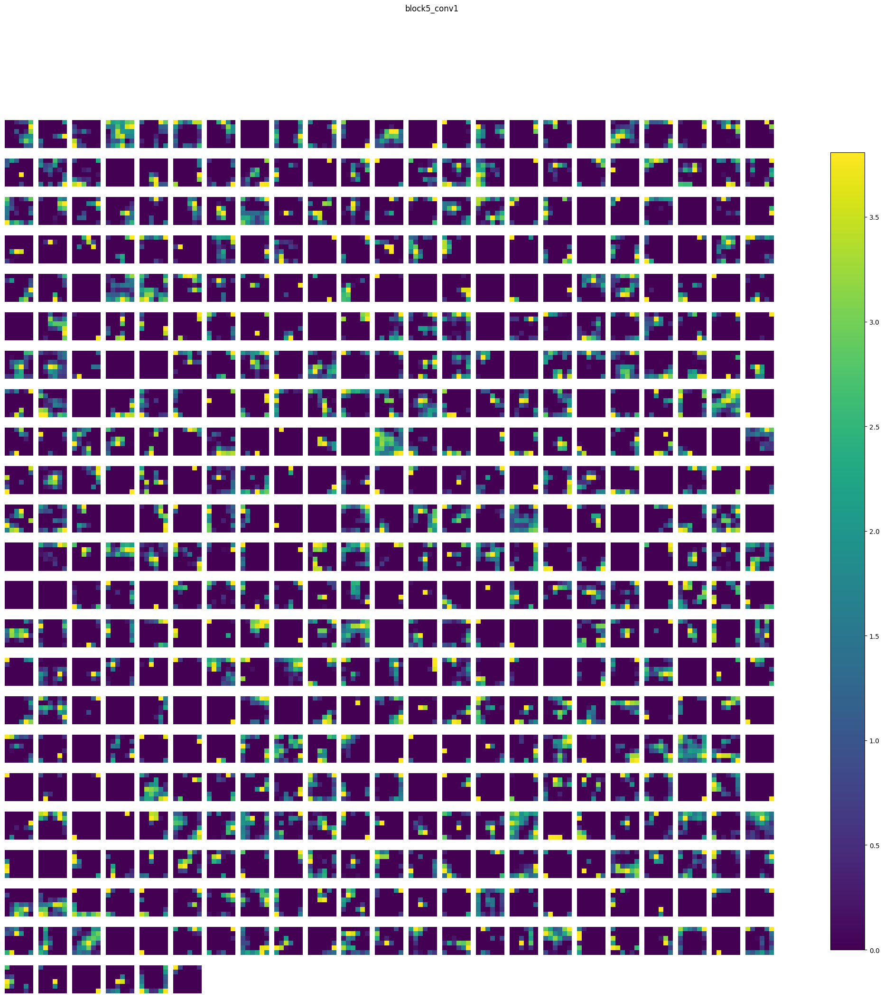

block5_conv2 (1, 6, 6, 512) 


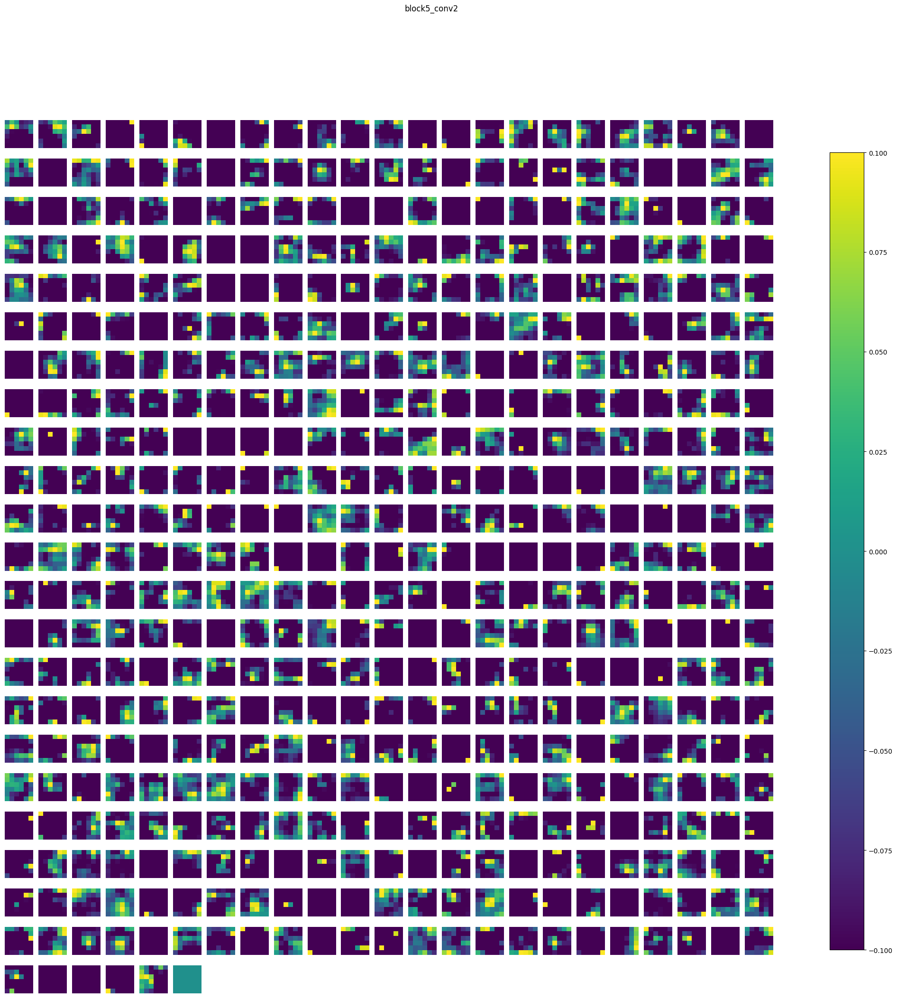

block5_conv3 (1, 6, 6, 512) 


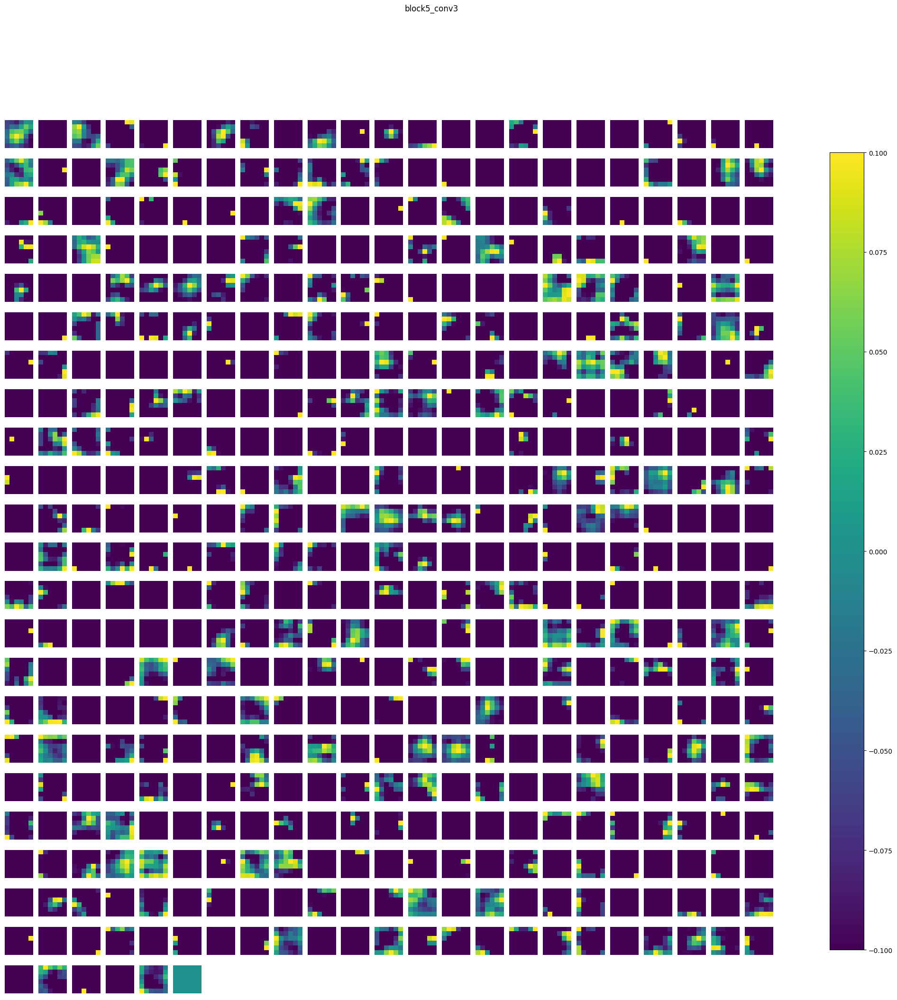

block5_pool (1, 3, 3, 512) 


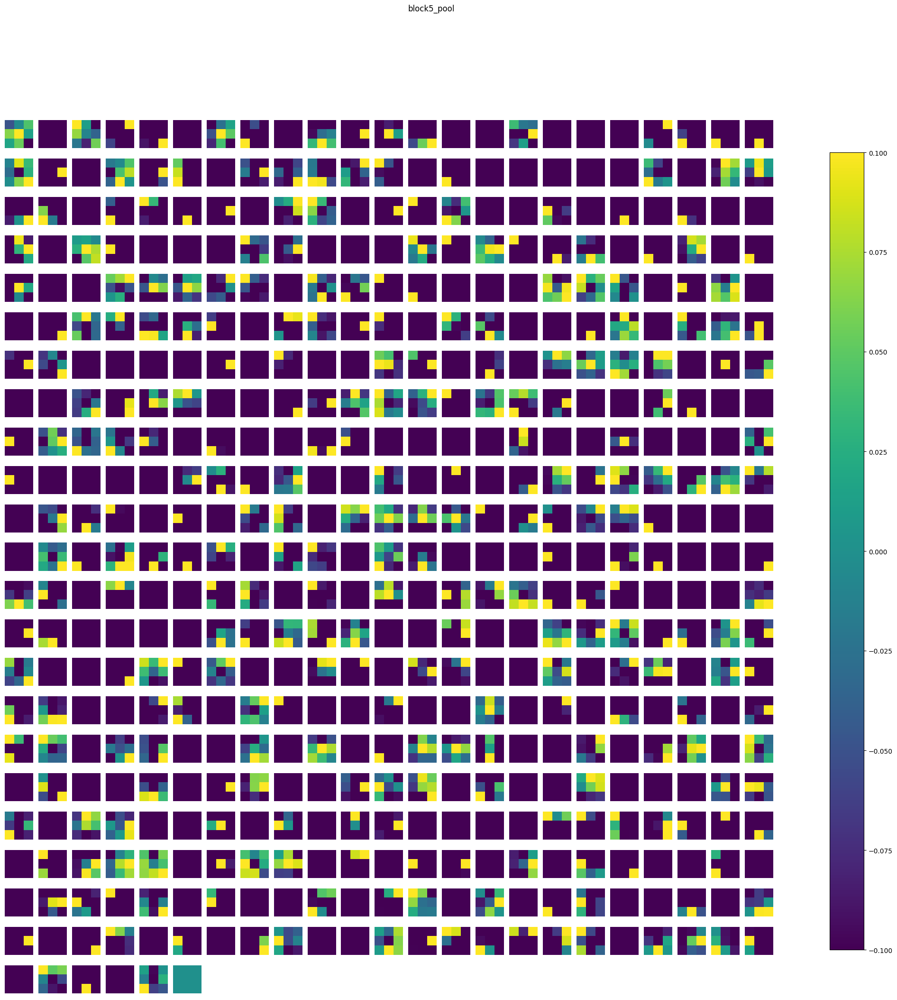

global_average_pooling2d (1, 512) 


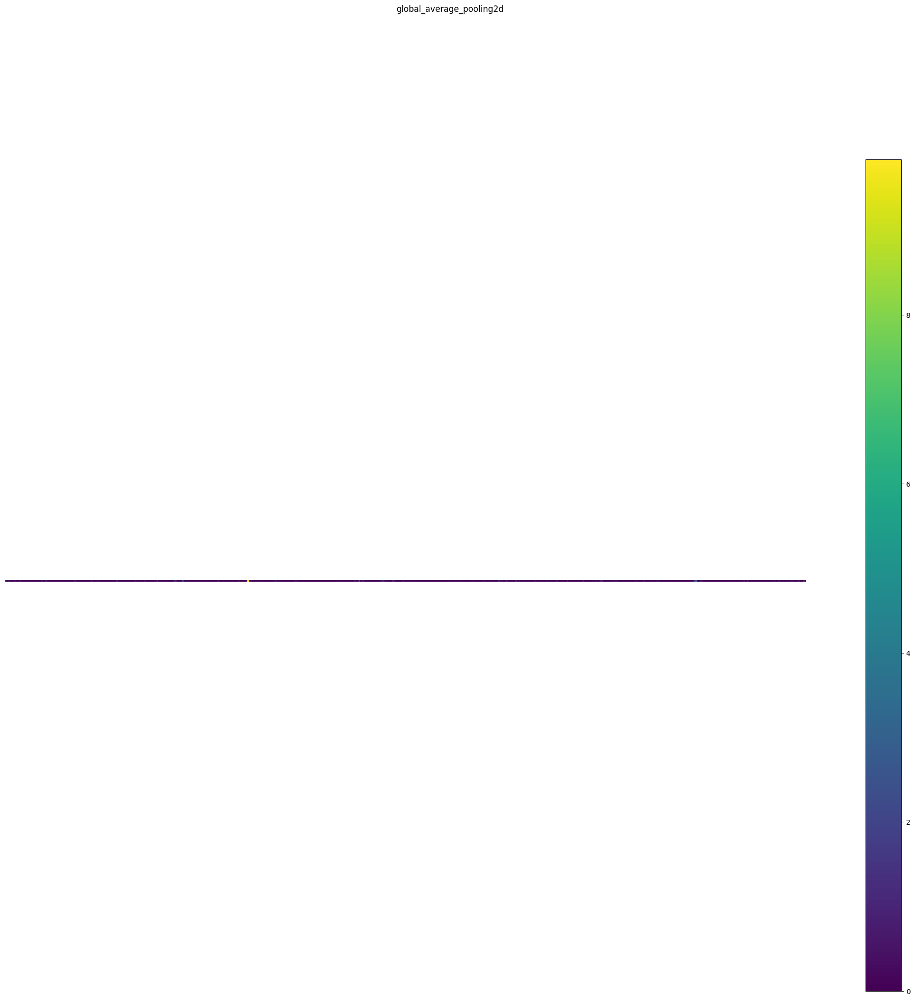

dense (1, 128) 


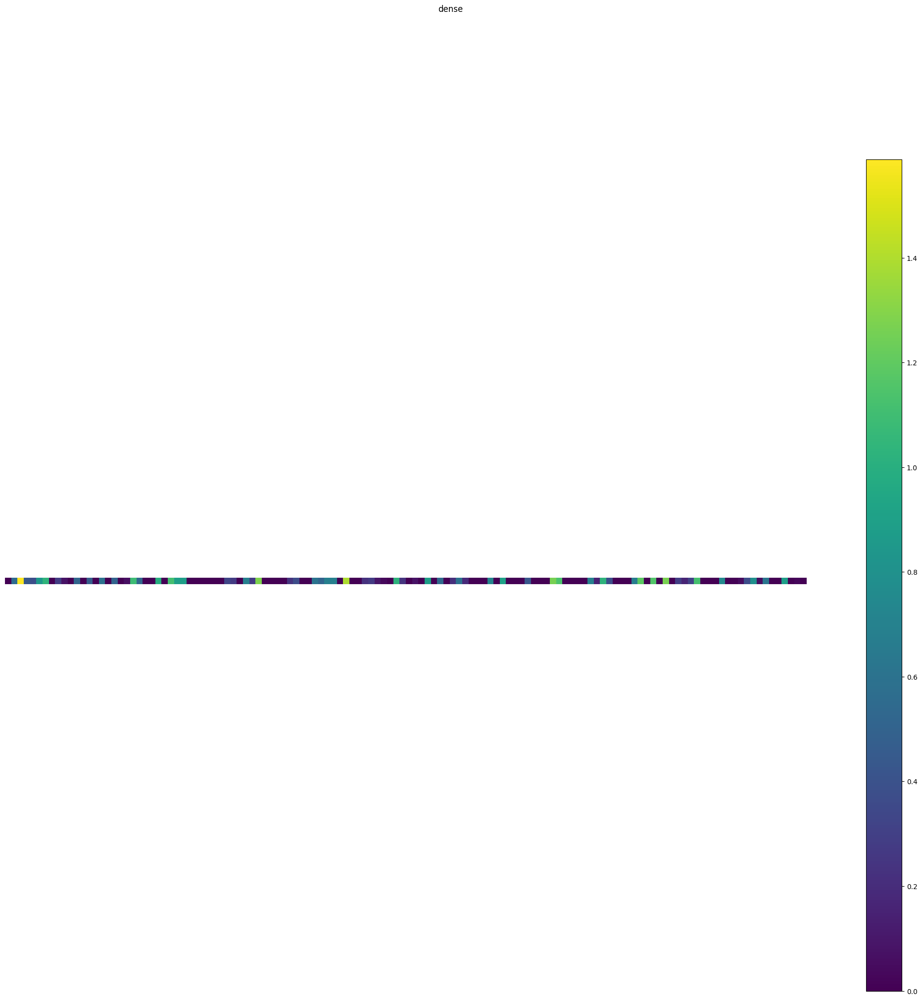

dense_1 (1, 7) 


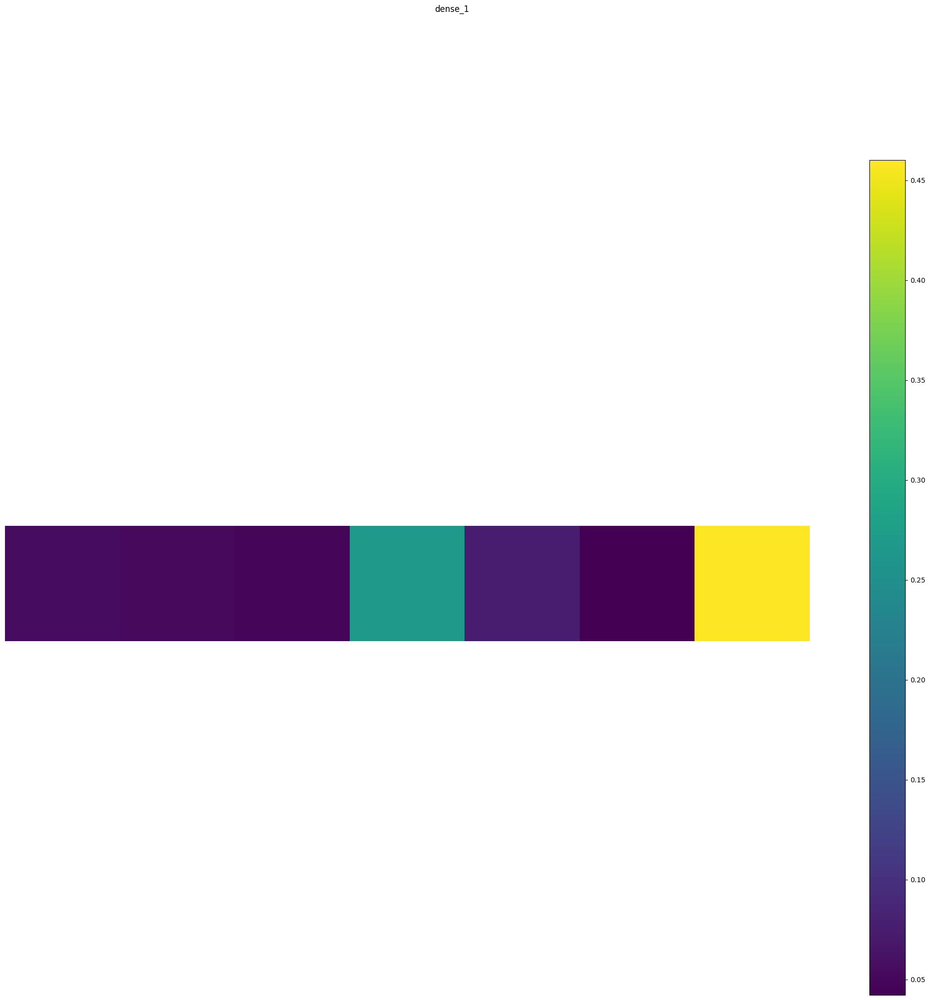

In [ ]:
def preprocess_image(img_path, model=None, rescale=255, resize=(256, 256)):
    """
    Preprocesses a given image for prediction with a trained model, with rescaling and resizing options

    Arguments:
            img_path: The path to the image file
            rescale: A float or integer indicating required rescaling.
                    The image array will be divided (scaled) by this number.
            resize: A tuple indicating desired target size.
                    This should match the input shape as expected by the model
    Returns:
            img: A processed image.
    """
    from tensorflow.keras.utils import img_to_array, load_img
    import cv2
    import numpy as np

    assert type(img_path) == str, "Image path must be a string"
    assert (
        type(rescale) == int or type(rescale) == float
    ), "Rescale factor must be either a float or int"
    assert (
        type(resize) == tuple and len(resize) == 2
    ), "Resize target must be a tuple with two elements"

    img = load_img(img_path)
    img = img_to_array(img)
    img = img / float(rescale)
    img = cv2.resize(img, resize)
    if model != None:
        if len(model.input_shape) == 4:
            img = np.expand_dims(img, axis=0)

    return img

x = preprocess_image(img_path="/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/shock/011_687_496_112_112.png",model=modelvgg,resize=(100,100))

from keract import get_activations
activations = get_activations(modelvgg, x)

from keract import display_activations
display_activations(activations, save=False)

In [ ]:
from keract import display_heatmaps

display_heatmaps(activations, x, save=False)

In [ ]:
x = preprocess_image(img_path="/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/shock/011_687_496_112_112.png",model=modelrn,resize=(100,100))

from keract import get_activations
activations = get_activations(modelrn, x)

from keract import display_activations
display_activations(activations, save=False)

Transfer learning

What is Transfer Learning ?
https://www.aismartz.com/blog/an-introduction-to-transfer-learning/
Transfer learning is a method wherein a model developed for a particular task is used as a starting point for another task. By model here, we mean a neural network that is trained with data and knowledge gained while solving one problem. For example, the knowledge gained in learning to recognize crocodiles can be used to recognize alligators because they have a lot of features in common.


In [ ]:
%matplotlib inline
import cv2
import os
from tensorflow.keras.applications.resnet_v2 import ResNet50V2
from tensorflow.python.keras.models import Sequential
from tensorflow.python.keras.layers import Dense

model = Sequential()
model.add(ResNet50V2(include_top = False, pooling = 'avg', weights = 'imagenet'))
model.add(Dense(7, activation = 'softmax'))
model.layers[0].trainable = True

In [ ]:
model.build(input_shape=(None,100,100,3))
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
module_wrapper (ModuleWrappe (None, 2048)              23564800  
_________________________________________________________________
dense (Dense)                (None, 7)                 14343     
Total params: 23,579,143
Trainable params: 23,533,703
Non-trainable params: 45,440
_________________________________________________________________


In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)

In [ ]:
from tensorflow.python.keras.callbacks import EarlyStopping

es = EarlyStopping(monitor = 'val_loss', patience = 5)

In [ ]:
from tensorflow.keras.applications.resnet_v2 import preprocess_input

## Preprocessing input
trainx = preprocess_input(trainx)
testx = preprocess_input(testx)

In [ ]:
history = model.fit_generator(
        datagen.flow(trainx,trainy,batch_size=32),
        steps_per_epoch=10,
        epochs = 10,
        validation_data=(testx, testy),
        validation_steps=10,
        callbacks=[es]
)

/usr/local/lib/python3.10/dist-packages/tensorflow/python/keras/engine/training.py:1961: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  warnings.warn('`Model.fit_generator` is deprecated and '


Epoch 1/10
10/10 [==============================] - 86s 9s/step - loss: 1.9438 - accuracy: 0.2094 - val_loss: 7.1152 - val_accuracy: 0.1304
Epoch 2/10
10/10 [==============================] - 76s 8s/step - loss: 1.8831 - accuracy: 0.2333 - val_loss: 4.6151 - val_accuracy: 0.1304
Epoch 3/10
10/10 [==============================] - 68s 7s/step - loss: 1.8662 - accuracy: 0.2600 - val_loss: 4.4103 - val_accuracy: 0.1957
Epoch 4/10
10/10 [==============================] - 69s 7s/step - loss: 1.9179 - accuracy: 0.2467 - val_loss: 2.9459 - val_accuracy: 0.1957
Epoch 5/10
10/10 [==============================] - 71s 7s/step - loss: 1.8311 - accuracy: 0.2867 - val_loss: 2.9010 - val_accuracy: 0.1957
Epoch 6/10
10/10 [==============================] - 116s 12s/step - loss: 1.8886 - accuracy: 0.2633 - val_loss: 4.0829 - val_accuracy: 0.1957
Epoch 7/10
10/10 [==============================] - 121s 12s/step - loss: 1.8448 - accuracy: 0.2906 - val_loss: 4.0510 - val_accuracy: 0.1304
Epoch 8/10
10/10

In [ ]:
modelrn.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)

hisrn=modelrn.fit(
        datagen.flow(trainx,trainy,batch_size=32),
        epochs = 30,
        validation_data=(testx, testy),
        callbacks=[es]
)

Epoch 1/30
12/12 [==============================] - 25s 2s/step - loss: 2.3257 - accuracy: 0.2665 - val_loss: 1.9307 - val_accuracy: 0.3261
Epoch 2/30
12/12 [==============================] - 19s 2s/step - loss: 1.7508 - accuracy: 0.3407 - val_loss: 1.7339 - val_accuracy: 0.3261
Epoch 3/30
12/12 [==============================] - 19s 2s/step - loss: 1.5567 - accuracy: 0.4231 - val_loss: 1.6595 - val_accuracy: 0.3696
Epoch 4/30
12/12 [==============================] - 21s 2s/step - loss: 1.4868 - accuracy: 0.4286 - val_loss: 1.6403 - val_accuracy: 0.4130
Epoch 5/30
12/12 [==============================] - 17s 1s/step - loss: 1.4911 - accuracy: 0.4670 - val_loss: 1.6138 - val_accuracy: 0.4022
Epoch 6/30
12/12 [==============================] - 17s 1s/step - loss: 1.3394 - accuracy: 0.5275 - val_loss: 1.5788 - val_accuracy: 0.4783
Epoch 7/30
12/12 [==============================] - 19s 2s/step - loss: 1.3631 - accuracy: 0.5027 - val_loss: 1.6644 - val_accuracy: 0.3587
Epoch 8/30
12/12 [==

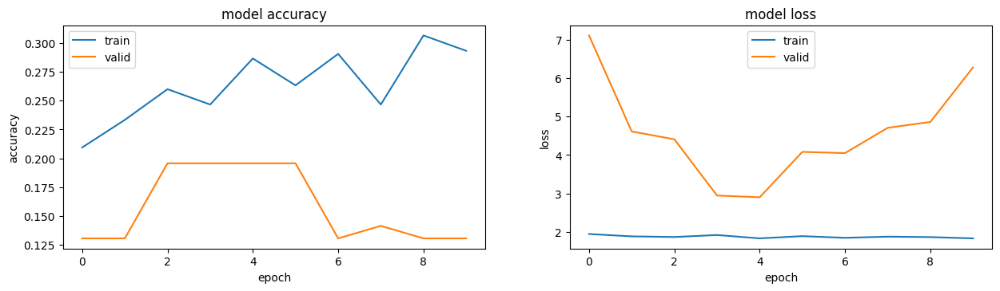

In [ ]:
plt.figure(1, figsize = (15,8))

plt.subplot(221)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'])

plt.subplot(222)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'])

plt.show()

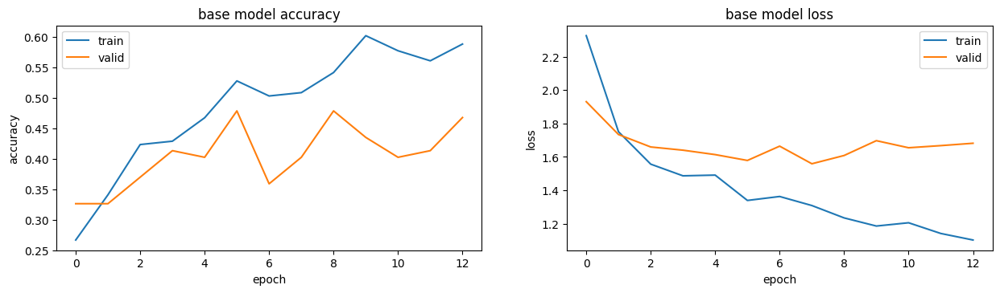

In [ ]:
plt.figure(1, figsize = (15,8))

plt.subplot(221)
plt.plot(hisrn.history['accuracy'])
plt.plot(hisrn.history['val_accuracy'])
plt.title('base model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'])

plt.subplot(222)
plt.plot(hisrn.history['loss'])
plt.plot(hisrn.history['val_loss'])
plt.title('base model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'])

plt.show()

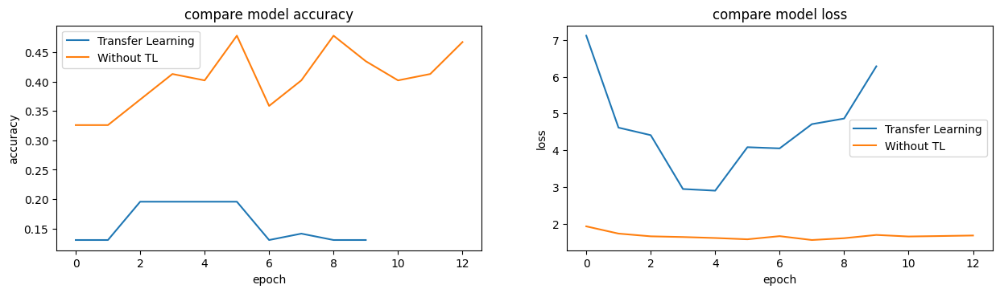

In [ ]:
plt.figure(1, figsize = (15,8))

plt.subplot(221)
plt.plot(history.history['val_accuracy'])
plt.plot(hisrn.history['val_accuracy'])
plt.title('compare model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['Transfer Learning', 'Without TL'])

plt.subplot(222)
plt.plot(history.history['val_loss'])
plt.plot(hisrn.history['val_loss'])
plt.title('compare model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['Transfer Learning', 'Without TL'])

plt.show()

In [ ]:
model.layers[0].trainable = False
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
module_wrapper (ModuleWrappe (None, 2048)              23564800  
_________________________________________________________________
dense (Dense)                (None, 7)                 14343     
Total params: 23,579,143
Trainable params: 14,343
Non-trainable params: 23,564,800
_________________________________________________________________


In [ ]:
history2 = model.fit(
        datagen.flow(trainx,trainy,batch_size=32),
        steps_per_epoch=10,
        epochs = 10,
        validation_data=(testx, testy),
        validation_steps=10,
        callbacks=[es]
)

Epoch 1/10
10/10 [==============================] - 76s 8s/step - loss: 0.7028 - accuracy: 0.7469 - val_loss: 2.4189 - val_accuracy: 0.4348
Epoch 2/10
10/10 [==============================] - 71s 7s/step - loss: 0.6289 - accuracy: 0.7600 - val_loss: 2.5645 - val_accuracy: 0.4565
Epoch 3/10
10/10 [==============================] - 64s 6s/step - loss: 0.5416 - accuracy: 0.8000 - val_loss: 2.3297 - val_accuracy: 0.4565
Epoch 4/10
10/10 [==============================] - 71s 7s/step - loss: 0.6369 - accuracy: 0.7767 - val_loss: 2.0961 - val_accuracy: 0.5217
Epoch 5/10
10/10 [==============================] - 68s 7s/step - loss: 0.5250 - accuracy: 0.8133 - val_loss: 2.7141 - val_accuracy: 0.4022
Epoch 6/10
10/10 [==============================] - 65s 7s/step - loss: 0.4914 - accuracy: 0.8167 - val_loss: 8.0330 - val_accuracy: 0.1739
Epoch 7/10
10/10 [==============================] - 69s 7s/step - loss: 0.6556 - accuracy: 0.7875 - val_loss: 4.8243 - val_accuracy: 0.2826
Epoch 8/10
10/10 [==

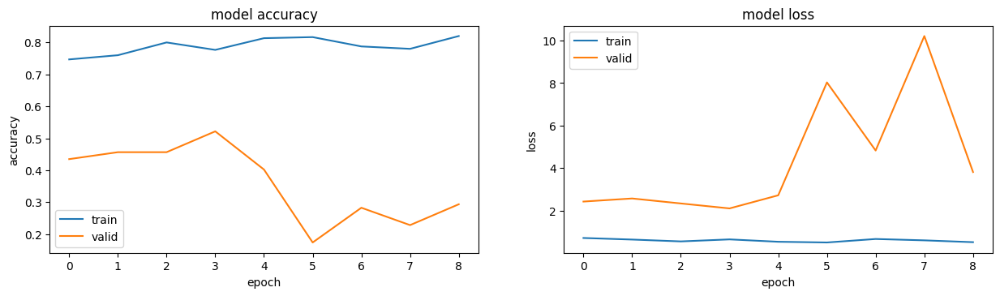

In [ ]:
plt.figure(1, figsize = (15,8))

plt.subplot(221)
plt.plot(history2.history['accuracy'])
plt.plot(history2.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'valid'])

plt.subplot(222)
plt.plot(history2.history['loss'])
plt.plot(history2.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'valid'])

plt.show()

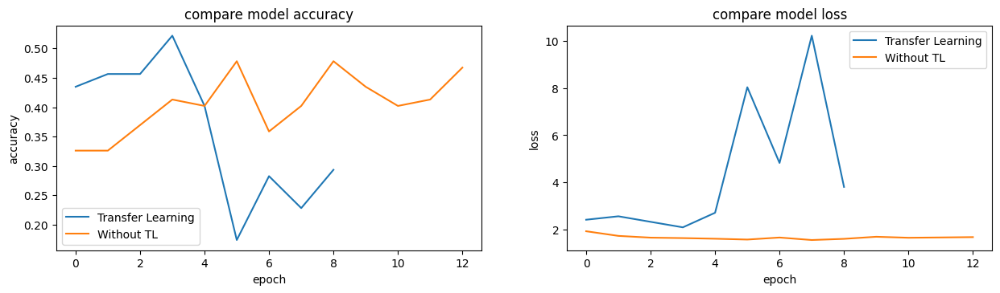

In [ ]:
plt.figure(1, figsize = (15,8))

plt.subplot(221)
plt.plot(history2.history['val_accuracy'])
plt.plot(hisrn.history['val_accuracy'])
plt.title('compare model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['Transfer Learning', 'Without TL'])

plt.subplot(222)
plt.plot(history2.history['val_loss'])
plt.plot(hisrn.history['val_loss'])
plt.title('compare model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['Transfer Learning', 'Without TL'])

plt.show()

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping

model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=5, restore_best_weights=True)

# Custom variable to track the best validation loss
best_val_losstl = float('inf')

# Initialize lists to store timestamps and corresponding CPU usages
timestampstl = []
cpu_usagestl = []

# Init plot material
acctl = []
losstl = []
val_acctl = []
val_losstl = []

# Start the training timer
start_time = time.time()

for epoch in range(50):
  histl = model.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  # Calculate CPU usage at the end of each epoch
  current_time = time.time()
  elapsed_time = current_time - start_time
  cpu_usagetl = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  timestampstl.append(elapsed_time)
  cpu_usagestl.append(cpu_usagetl)

  # Track the best validation loss
  current_val_losstl = histl.history['val_loss'][0]
  if current_val_losstl < best_val_losstl:
    best_val_losstl = current_val_losstl

  # Collect results for plot
  acctl.append(histl.history['accuracy'][0])
  val_acctl.append(histl.history['val_accuracy'][0])
  losstl.append(histl.history['loss'][0])
  val_losstl.append(histl.history['val_loss'][0])

  # Check for early stopping condition
  if epoch - early_stopping.patience >= early_stopping.stopped_epoch:
    print("Early stopping at epoch", epoch + 1)
    break

# End of training
print("Training completed.")

# Print the timestamps and CPU usages
for timestamp, cpu_usage in zip(timestampstl, cpu_usagestl):
    print(f"Time: {timestamp:.2f}s, CPU Usage: {cpu_usage:.2f}%")

In [ ]:
y_pred=model.predict(testx)
pred=np.argmax(y_pred,axis=1)
ground = np.argmax(testy,axis=1)
print(classification_report(ground,pred))

In [ ]:
epochs = range(len(acctl))
plt.plot(epochs, acctl, 'r', label='Accuracy of Training data')
plt.plot(epochs, val_acctl, 'b', label='Accuracy of Validation data')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
epochs = range(len(losstl))
plt.plot(epochs, losstl, 'r', label='Loss of Training data')
plt.plot(epochs, val_losstl, 'b', label='Loss of Validation data')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
cpu_tl = []
time_tl = []
start_time = time.time()
acctl30 = []
losstl30 = []
val_acctl30 = []
val_losstl30 = []

for epoch in range(30):
  history30_tl = model.fit(datagen.flow(trainx,trainy,batch_size=32), epochs=1,
                        validation_data=(testx,testy), verbose=0)

  cpu_tl_current = psutil.cpu_percent(interval=0.1)  # Interval of 0.1 seconds for CPU usage measurement
  cpu_tl.append(cpu_tl_current)

  current_time = time.time()
  elapsed_time = current_time - start_time
  time_tl.append(elapsed_time)

  # Collect results for plot
  acctl30.append(history30_tl.history['accuracy'][0])
  val_acctl30.append(history30_tl.history['val_accuracy'][0])
  losstl30.append(history30_tl.history['loss'][0])
  val_losstl30.append(history30_tl.history['val_loss'][0])

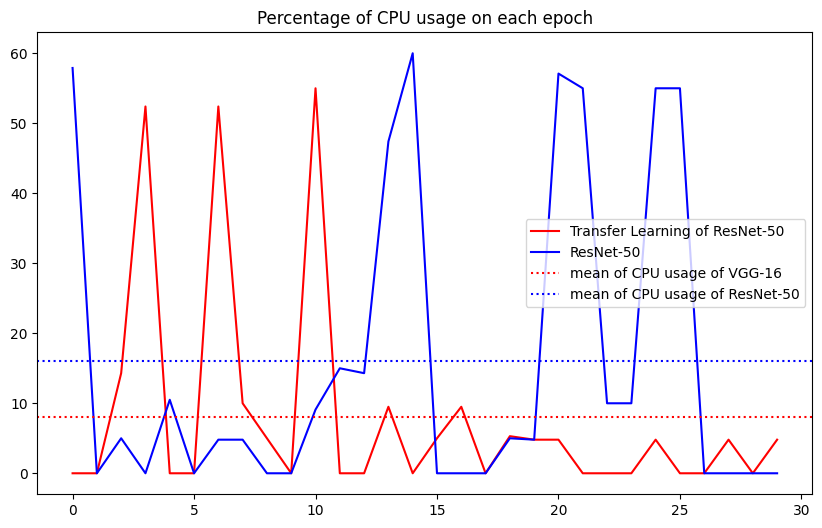

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(30)
plt.figure(figsize=(10, 6))
plt.plot(epochs, cpu_tl, 'r', label='Transfer Learning of ResNet-50')
plt.plot(epochs, cpu_rn, 'b', label='ResNet-50')
plt.axhline(y=np.mean(cpu_tl), color='r', linestyle=':', label='mean of CPU usage of Transfer Learning')
plt.axhline(y=np.mean(cpu_rn), color='b', linestyle=':', label='mean of CPU usage of ResNet-50')
plt.title('Percentage of CPU usage on each epoch')
plt.legend(loc=0)
plt.figure()
plt.show()

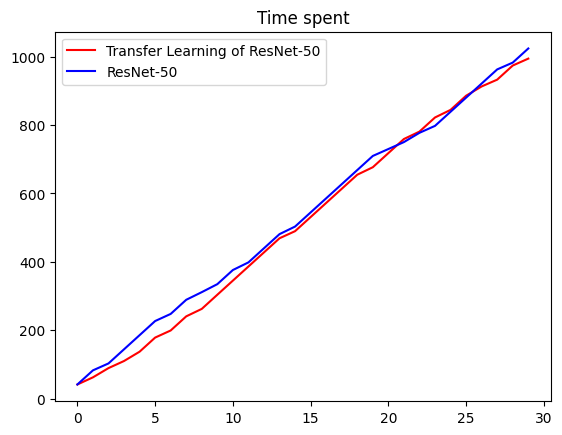

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(30)
plt.plot(epochs, time_tl, 'r', label='Transfer Learning of ResNet-50')
plt.plot(epochs, time_rn, 'b', label='ResNet-50')
plt.title('Time spent')
plt.legend(loc=0)
plt.figure()
plt.show()

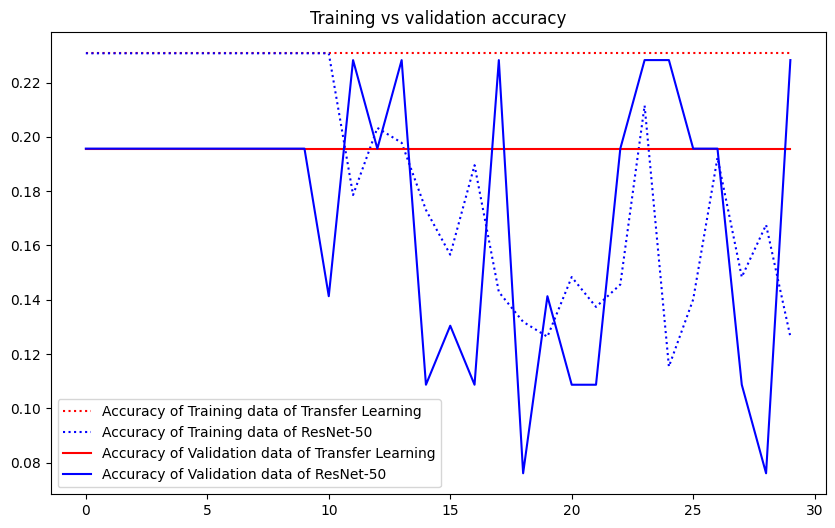

<Figure size 640x480 with 0 Axes>

In [ ]:
epochs = range(30)
plt.figure(figsize=(10, 6))
plt.plot(epochs, acctl30, 'r', label='Accuracy of Training data of Transfer Learning', linestyle=':')
plt.plot(epochs, accrn30, 'b', label='Accuracy of Training data of ResNet-50', linestyle=':')
plt.plot(epochs, val_acctl30, 'r', label='Accuracy of Validation data of Transfer Learning')
plt.plot(epochs, val_accrn30, 'b', label='Accuracy of Validation data of ResNet-50')
plt.title('Training vs validation accuracy')
plt.legend(loc=0)
plt.figure()
plt.show()

In [ ]:
epochs = range(len(losstl))
plt.figure(figsize=(10, 6))
plt.plot(epochs, losstl30, 'r', label='Loss of Training data of Transfer Learning', linestyle=':')
plt.plot(epochs, lossrn30, 'b', label='Loss of Training data of ResNet-50', linestyle=':')
plt.plot(epochs, val_losstl30, 'r', label='Loss of Validation data of Transfer Learning')
plt.plot(epochs, val_lossrn30, 'b', label='Loss of Validation data of ResNet-50')
plt.title('Training vs validation loss')
plt.legend(loc=0)
plt.figure()
plt.show()

NameError: ignored

KNN https://medium.com/swlh/image-classification-with-k-nearest-neighbours-51b3a289280

In [ ]:
import numpy as np
from keras.preprocessing import image
import cv2 as cv
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.model_selection import GridSearchCV, train_test_split
from skimage.io import imread
print("Files imported successfully")
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', 30*30 + 1)

Files imported successfully


In [ ]:
def unique(list1):

    # initialize a null list
    unique_list = []

    # traverse for all elements
    for x in list1:
        # check if exists in unique_list or not
        if x not in unique_list:
            unique_list.append(x)
    return unique_list

In [ ]:
# import necessary packages
!pip install imutils

import os
import glob
import cv2
import numpy as np
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import  train_test_split
from sklearn.metrics import classification_report
from imutils import paths

def getListOfFiles(dirName):
    # create a list of file and sub directories
    # names in the given directory
    listOfFile = os.listdir(dirName)
    allFiles = list()
    # Iterate over all the entries
    for entry in listOfFile:
        # Create full path
        fullPath = os.path.join(dirName, entry)
        # If entry is a directory then get the list of files in this directory
        if os.path.isdir(fullPath):
            allFiles = allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)

    return allFiles

imagePaths = getListOfFiles("/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train")
## Folder structure: datasets --> sub-folders with labels name
#print(imagePaths)

data = []
labels = []
cate = []
images = []
flat_data = []
target = []
train_img = []
c = 0 ## to see the progress
for image in imagePaths:

    label = os.path.split(os.path.split(image)[0])[1]
    labels.append(label)
    cate.append(label)

    img = cv2.imread(image)
    #img = cv2.resize(img, (50, 50), interpolation = cv2.INTER_AREA)
    #data.append(img)

    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, (50, 50), interpolation = cv2.INTER_AREA)
    img = img_to_array(img)
    img = img / 255
    train_img.append(img)
    data.append(img)

    c=c+1
    #print(c)

X = np.array(train_img)

y0 = np.zeros(54)
#53 is the number of Angry in X

y1 = np.ones(55)
#55 is the number of Crying in X

y2 = np.zeros(66)
#66 is the number of Embarrassed in X

y3 = np.ones(86)
#86 is the number of Happy in X

y4 = np.zeros(37)
#37 is the number of Pleased in X

y5 = np.ones(56)
#56 is the number of Sad in X

y6 = np.zeros(102)
#102 is the number of Shock in X

Y = []
Y = np.concatenate((y0,y1,y2,y3,y4,y5,y6), axis=0)

#print("data: "+str(data.shape))
#print("labels: "+str(labels.shape))
#print("dataset_size: "+str(dataset_size))

(X_train, X_test, y_train, y_test) = train_test_split(X, Y, random_state=42, test_size= 0.2)
(X_val, X_test, y_val, y_test) = train_test_split(X_test, y_test, random_state=42, test_size=0.5)

print("X_train: "+str(X_train.shape))
print("X_test: "+str(X_test.shape))
print("X_val: "+str(X_val.shape))
print("y_train: "+str(y_train.shape))
print("y_test: "+str(y_test.shape))
print("y_val: "+str(y_val.shape))

from builtins import range
from builtins import object

num_training = X_train.shape[0]
mask = list(range(num_training))
X_train = X_train[mask]
y_train = y_train[mask]

num_test = X_test.shape[0]
mask = list(range(num_test))
X_test = X_test[mask]
y_test = y_test[mask]

num_val = X_val.shape[0]
mask = list(range(num_val))
X_val = X_val[mask]
y_val = y_val[mask]

# Reshape the image data into rows
X_train = np.reshape(X_train, (X_train.shape[0], -1))
X_test = np.reshape(X_test, (X_test.shape[0], -1))
X_val = np.reshape(X_val, (X_val.shape[0], -1))

print("X_train: "+str(X_train.shape))
print("X_test: "+str(X_test.shape))
print("X_val: "+str(X_val.shape))
print("y_train: "+str(y_train.shape))
print("y_test: "+str(y_test.shape))
print("y_val: "+str(y_val.shape))

X_train: (364, 50, 50, 1)
X_test: (46, 50, 50, 1)
X_val: (46, 50, 50, 1)
y_train: (364,)
y_test: (46,)
y_val: (46,)
X_train: (364, 2500)
X_test: (46, 2500)
X_val: (46, 2500)
y_train: (364,)
y_test: (46,)
y_val: (46,)


In [ ]:
cate = ['angry', 'crying', 'embarrassed', 'happy', 'pleased', 'sad', 'shock']

In [ ]:
class KNearestNeighbor(object):
    """ a kNN classifier with L2 distance """

    def __init__(self):
        pass

    def predict_label(self, dists, k=1):
        num_test = dists.shape[0]
        y_pred = np.zeros(num_test)
        for i in range(num_test):
            closest_y = []
            closest_y = self.y_train[np.argsort(dists[i])][0:k]
            y_pred[i] = np.bincount(closest_y).argmax()
        return y_pred

    def train(self, X, y):
        """
        Train the classifier. For k-nearest neighbors this is just
        memorizing the training data.

        Inputs:
        - X: A numpy array of shape (num_train, D) containing the training data
          consisting of num_train samples each of dimension D.
        - y: A numpy array of shape (N,) containing the training labels, where
             y[i] is the label for X[i].
        """
        self.X_train = X
        self.y_train = y

    def predict(self, X, k=1):
        """
        Predict labels for test data using this classifier.

        Inputs:
        - X: A numpy array of shape (num_test, D) containing test data consisting
             of num_test samples each of dimension D.
        - k: The number of nearest neighbors that vote for the predicted labels.
        - num_loops: Determines which implementation to use to compute distances
          between training points and testing points.

        Returns:
        - y: A numpy array of shape (num_test,) containing predicted labels for the
          test data, where y[i] is the predicted label for the test point X[i].
        """
        dists = self.compute_distances_no_loops(X)

        return self.predict_labels(dists, k=k)

    def compute_distances_no_loops(self, X):
        """
        Compute the distance between each test point in X and each training point
        in self.X_train using no explicit loops.

        Input / Output: Same as compute_distances_two_loops
        """
        num_test = X.shape[0]
        num_train = self.X_train.shape[0]
        dists = np.zeros((num_test, num_train))
        #########################################################################
        dists = np.sqrt((X ** 2).sum(axis=1, keepdims=1) + (self.X_train ** 2).sum(axis=1) - 2 * X.dot(self.X_train.T))

        return dists

    def predict_labels(self, dists, k=1):
        """
        Given a matrix of distances between test points and training points,
        predict a label for each test point.

        Inputs:
        - dists: A numpy array of shape (num_test, num_train) where dists[i, j]
          gives the distance betwen the ith test point and the jth training point.

        Returns:
        - y: A numpy array of shape (num_test,) containing predicted labels for the
          test data, where y[i] is the predicted label for the test point X[i].
        """
        num_test = dists.shape[0]
        y_pred = np.zeros(num_test)
        for i in range(num_test):
            # A list of length k storing the labels of the k nearest neighbors to
            # the ith test point.
            closest_y = []
            closest_y = self.y_train[np.argsort(dists[i])][0:k]
            closest_y = closest_y.astype(int)
            y_pred[i] = np.bincount(closest_y).argmax()
        return y_pred

Train

In [ ]:
print("Val Accuracy for k=1")
classifier = KNearestNeighbor()
classifier.train(X_train, y_train)
dists = classifier.compute_distances_no_loops(X_val)
y_val_pred = classifier.predict_labels(dists, k=1)
num_correct = np.sum(y_val_pred == y_val)
accuracy = float(num_correct) / num_val
print('Got %d / %d correct => accuracy: %f' % (num_correct, num_val, accuracy))

Val Accuracy for k=1
Got 20 / 46 correct => accuracy: 0.434783


Using SKLEARN


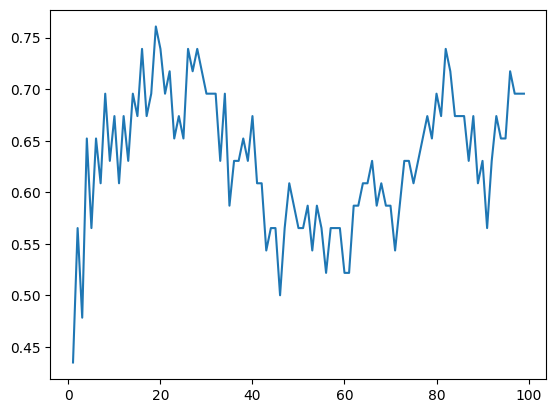

max acc at k=19 acc of 0.7608695652173914


In [ ]:
print("Using SKLEARN")
lix = []
liy = []
index=0
acc=0
from sklearn.neighbors import KNeighborsClassifier
for k in range(1, 100):
    neigh = KNeighborsClassifier(n_neighbors=k)
    neigh.fit(X_train, y_train)
    liy.append(neigh.score(X_val, y_val))
    if liy[k-1]>acc:
        acc=liy[k-1]
        index=k-1
    lix.append(k)

plt.plot(lix, liy)
plt.show()
print("max acc at k="+str(index+1)+" acc of "+str(acc))

In [ ]:
neigh = KNeighborsClassifier(n_neighbors=43)
neigh.fit(X_train, y_train)
print("Test Accuracy: "+str(neigh.score(X_test, y_test)))

print("Using our own k-NN")
classifier = KNearestNeighbor()
classifier.train(X_train, y_train)
dists = classifier.compute_distances_no_loops(X_test)
y_test_pred = classifier.predict_labels(dists, k=12)
num_correct = np.sum(y_test_pred == y_test)
accuracy = float(num_correct) / num_test
print('With k = 43 Got %d / %d correct => accuracy: %f' % (num_correct, num_test, accuracy))

Test Accuracy: 0.6086956521739131
Using our own k-NN
With k = 43 Got 26 / 46 correct => accuracy: 0.565217


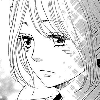

In [ ]:
load_img("/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/sad/023_255_474_305_305.png",target_size=(100,100))

Test

In [ ]:
print("Predicting custom image")
img = cv2.imread("/content/drive/MyDrive/TER/tensorflow_vgg_master/test_data/Manga Facial/Train/sad/023_255_474_305_305.png")
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
img_pred = cv2.resize(img, (50, 50), interpolation=cv2.INTER_AREA)
img_pred = img_to_array(img_pred)
img_pred = img_pred/25
img_pred = np.reshape(img_pred, (1, img_pred.shape[0]*img_pred.shape[1]))

classifier2 = KNearestNeighbor()
classifier2.train(X_train, y_train)
# Test your implementation:
dists = classifier2.compute_distances_no_loops(img_pred)
y_test_pred = classifier2.predict_labels(dists, k=12)
#y_test_pred = unique(y_test_pred.tolist())
print(cate[int(y_test_pred)])

Predicting custom image
sad


Conclusion:
The k-NN algorithm gives a testing accuracy of 59.17% for the Cats and Dogs dataset, only a bit better than random guessing (50%) and a large distance from human performance (~95%). The k-Nearest Neighbour is hence, near only in it’s etymology.